<h1>Dataset Overview</h1>
_________________________________________________________________

For this project, we used the **Car Damage Classification Dataset** obtainedfrom **Kaggle**.  
The dataset contains **1,594 RGB images** of vehicles showing different types of damage.  
These images are divided into **8 categories**


## <h1>Dataset Import</h1>

In [ ]:
import kagglehub
hamzamanssor_car_damage_assessment_path = kagglehub.dataset_download('hamzamanssor/car-damage-assessment')

print('Data source import complete.')


100%|██████████| 16.0M/16.0M [00:01<00:00, 12.7MB/s]

Extracting files...


Data source import complete.


In [ ]:
!pip install --upgrade tensorflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 620.7/620.7 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 42.5 MB/s eta 0:00:00
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.19.0
    Uninstalling tensorboard-2.19.0:
      Successfully uninstalled tensorboard-2.19.0
  Attempting uninstall: tensorflow
    Found existing installation: tensorflow 2.19.0
    Uninstalling tensorflow-2.19.0:
      Successfully uninstalled tensorflow-2.19.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tf-keras 2.19.0 requires tensorflow<2.20,>=2.19, but you have tensorflow 2.20.0 which is incompatible.
tensorflow-text 2.19.0 requires tensorflow<2.20,>=2.19.0, but you have tensorflow 2.20.0 which is incompatible.
tensorflow-decision-forests 1.12.0 requires tensorflow==2.19.0, but you have tensorflow 2.20.0 which is inc

In [ ]:
!pip install -q keras-tuner


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.4/129.4 kB 3.4 MB/s eta 0:00:00


##Libraries Import

In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, GlobalAveragePooling2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
from PIL import Image
from tensorflow.keras.applications import DenseNet201
from tensorflow.keras.models import Model
import shutil
from tensorflow.keras.models import load_model
import random
import keras_tuner as kt
from sklearn.preprocessing import LabelEncoder
import os
import numpy as np
import pandas as pd
import joblib
from tqdm import tqdm
import matplotlib.pyplot as plt

# sklearn
from sklearn.preprocessing import LabelEncoder, StandardScaler, label_binarize
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import (
    accuracy_score,
    classification_report,
    confusion_matrix,
    roc_auc_score
)

# TensorFlow / Keras
import tensorflow as tf
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.efficientnet import preprocess_input
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.layers import GlobalAveragePooling2D
from tensorflow.keras.models import Model


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!mkdir -p /content/drive/MyDrive/Dataset/input/
!cp -r /root/.cache/kagglehub/datasets/hamzamanssor/car-damage-assessment/versions/1 /content/drive/MyDrive/Dataset/input/car-damage-assessment
print("✅ Copied dataset to Google Drive successfully!")


^C
✅ Copied dataset to Google Drive successfully!


In [ ]:
CSV_PATH = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/data.csv'
IMG_FOLDER = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/image'
!ls /content/drive/MyDrive/Dataset/input/car-damage-assessment/1

data.csv  image  processed_images  test.csv  train.csv	val.csv


## Preprocessing & EDA
<h5>_______________________________________________________________________________________</h5>
<h4>Preprocessing and Exploratory Data Analysis (EDA) are essential steps in any machine learning project.They involve preparing and understanding the data before model training.Preprocessing focuses on cleaning and transforming the data into a suitable format,while EDA helps identify patterns, relationships, and potential issues in the dataset.Together, these steps ensure that the model is trained on high-quality and well-understood data.</h4>

Loading dataset CSV...
 CSV loaded successfully! Shape: (1594, 3)

 First 5 rows:
   Unnamed: 0         image       classes
0           0  image/0.jpeg       unknown
1           1  image/1.jpeg     head_lamp
2           2  image/2.jpeg  door_scratch
3           3  image/3.jpeg     head_lamp
4           4  image/4.jpeg       unknown

 Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1594 entries, 0 to 1593
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Unnamed: 0  1594 non-null   int64 
 1   image       1594 non-null   object
 2   classes     1594 non-null   object
dtypes: int64(1), object(2)
memory usage: 37.5+ KB
None

 Missing Values per Column:
Unnamed: 0    0
image         0
classes       0
dtype: int64

 Class column detected: 'classes'

 Unique Classes in 'classes': ['unknown' 'head_lamp' 'door_scratch' 'glass_shatter' 'tail_lamp'
 'bumper_dent' 'door_dent' 'bumper_scratch']
 Count of 'unknown' s

/tmp/ipython-input-4144247886.py:56: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x=class_col, order=df[class_col].value_counts().index, palette="viridis")


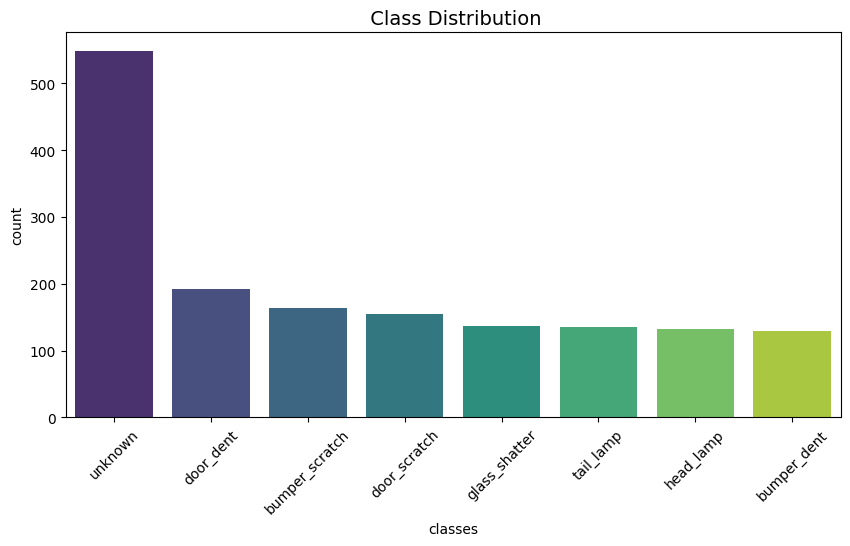


 Missing image files: 0
Empty DataFrame
Columns: [Unnamed: 0, image, classes, exists]
Index: []

 Valid image files: 1594


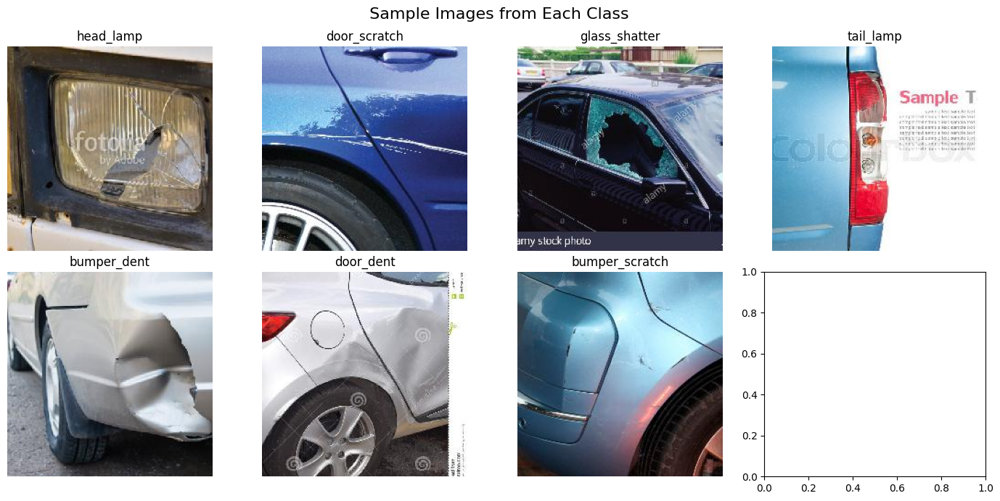


 PHASE 0 COMPLETE!
Total images: 1594
Valid images: 1594
Unknown class count: 549


In [ ]:
# ==========================================
#  PHASE 0: DATA UNDERSTANDING & EDA
# ==========================================
# Objective: Understand dataset structure, distribution, and quality
# ==========================================

import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image

# ==========================================
#  Define dataset paths
# ==========================================
CSV_PATH = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/data.csv'
IMG_FOLDER = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/'  # Base path

# ==========================================
#  Load the dataset
# ==========================================
print("Loading dataset CSV...")
df = pd.read_csv(CSV_PATH)
print(" CSV loaded successfully! Shape:", df.shape)

print("\n First 5 rows:")
print(df.head())

# ==========================================
# Basic info
# ==========================================
print("\n Dataset Info:")
print(df.info())

print("\n Missing Values per Column:")
print(df.isnull().sum())

# Detect the class column
class_col = 'classes' if 'classes' in df.columns else None
print(f"\n Class column detected: '{class_col}'")

# ==========================================
#  Unique class distribution
# ==========================================
unique_classes = df[class_col].unique()
print("\n Unique Classes in 'classes':", unique_classes)

# Count of 'unknown' class
unknown_count = (df[class_col] == 'unknown').sum()
print(f" Count of 'unknown' samples: {unknown_count}")

# ==========================================
#  Visualize class distribution
# ==========================================
plt.figure(figsize=(10,5))
sns.countplot(data=df, x=class_col, order=df[class_col].value_counts().index, palette="viridis")
plt.title(" Class Distribution", fontsize=14)
plt.xticks(rotation=45)
plt.show()

# ==========================================
#  Fix image paths
# ==========================================
# Each image in the CSV is stored like: image/1.jpeg
# but actual path = /.../1/image/1.jpeg
df['image'] = df['image'].apply(lambda x: f"1/{x}")

# ==========================================
#  Verify image existence
# ==========================================
def check_image_exists(row):
    img_path = os.path.join(IMG_FOLDER, row['image'])
    return os.path.exists(img_path)

df['exists'] = df.apply(check_image_exists, axis=1)
missing_images = df[~df['exists']]

print(f"\n Missing image files: {len(missing_images)}")
print(missing_images.head())

valid_images = df[df['exists']]
print(f"\n Valid image files: {len(valid_images)}")

# ==========================================
#  Visualize a few sample images (excluding 'unknown')
# ==========================================
valid_images_no_unknown = valid_images[valid_images[class_col] != 'unknown']

if len(valid_images_no_unknown) > 0:
    sample_labels = valid_images_no_unknown[class_col].unique()[:8]
    fig, axes = plt.subplots(2, 4, figsize=(14, 7))
    axes = axes.flatten()

    for i, label in enumerate(sample_labels):
        sample_row = valid_images_no_unknown[valid_images_no_unknown[class_col] == label].iloc[0]
        img_path = os.path.join(IMG_FOLDER, sample_row['image'])
        img = Image.open(img_path)
        axes[i].imshow(img)
        axes[i].set_title(label)
        axes[i].axis("off")

    plt.suptitle(" Sample Images from Each Class", fontsize=16)
    plt.tight_layout()
    plt.show()
else:
    print(" No valid non-'unknown' images found for visualization.")

# ==========================================
#  Summary
# ==========================================
print("\n PHASE 0 COMPLETE!")
print(f"Total images: {len(df)}")
print(f"Valid images: {len(valid_images)}")
print(f"Unknown class count: {unknown_count}")


 Loading dataset...
 Dataset loaded successfully! Shape: (1594, 3)
 Dropped 'Unnamed: 0' column.
 Removed 549 'unknown' samples. Remaining: 1045
 All image files verified and exist.

 Split summary:
Training set: 731 samples
Validation set: 157 samples
Test set: 157 samples

 Saved cleaned and split datasets:
 - train.csv  → 731 samples
 - val.csv    → 157 samples
 - test.csv   → 157 samples


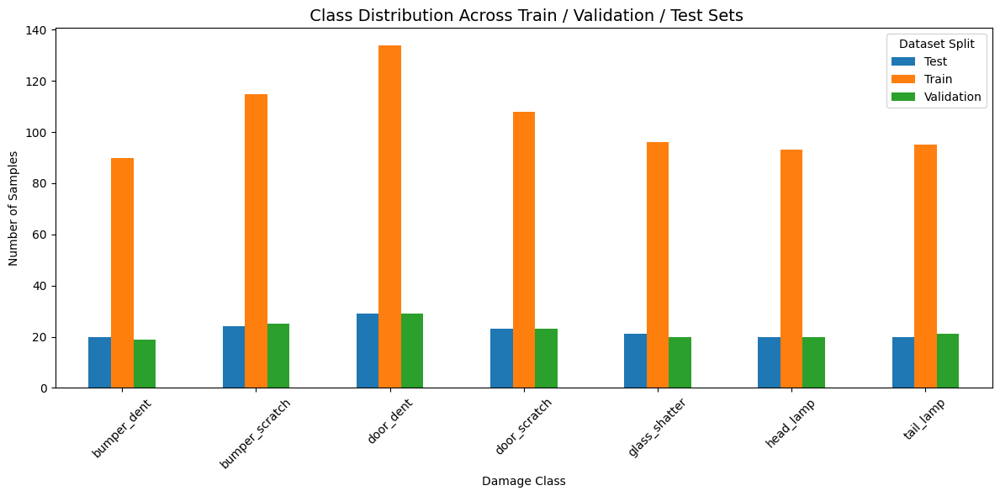


 PHASE 1 COMPLETE — data cleaned, split, saved, and verified visually!


In [ ]:
#  Starting Phase 1: Data Cleaning, Preparation & Split Verification
import os
import pandas as pd
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

# -------------------------------
#  Load the dataset
# -------------------------------
CSV_PATH = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/data.csv'
IMG_FOLDER = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/image'

print(" Loading dataset...")
df = pd.read_csv(CSV_PATH)
print(f" Dataset loaded successfully! Shape: {df.shape}")

# -------------------------------
# Drop unnecessary columns
# -------------------------------
if 'Unnamed: 0' in df.columns:
    df.drop(columns=['Unnamed: 0'], inplace=True)
    print(" Dropped 'Unnamed: 0' column.")

# -------------------------------
#  Remove 'unknown' class
# -------------------------------
unknown_count = df[df['classes'] == 'unknown'].shape[0]
df = df[df['classes'] != 'unknown']
print(f" Removed {unknown_count} 'unknown' samples. Remaining: {len(df)}")

# -------------------------------
#  Verify image files exist
# -------------------------------
df['exists'] = df['image'].apply(lambda x: os.path.exists(os.path.join(IMG_FOLDER, os.path.basename(x))))
missing_images = df[~df['exists']]
if len(missing_images) > 0:
    print(f" Missing image files: {len(missing_images)} — removing them...")
    df = df[df['exists']]
else:
    print(" All image files verified and exist.")
df.drop(columns=['exists'], inplace=True)

# -------------------------------
#  Split dataset (70 / 15 / 15)
# -------------------------------
train_df, temp_df = train_test_split(df, test_size=0.30, stratify=df['classes'], random_state=42)
val_df, test_df = train_test_split(temp_df, test_size=0.50, stratify=temp_df['classes'], random_state=42)

print(f"\n Split summary:")
print(f"Training set: {len(train_df)} samples")
print(f"Validation set: {len(val_df)} samples")
print(f"Test set: {len(test_df)} samples")

# -------------------------------
#  Save clean & split data
# -------------------------------
output_dir = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/1'
train_df.to_csv(os.path.join(output_dir, 'train.csv'), index=False)
val_df.to_csv(os.path.join(output_dir, 'val.csv'), index=False)
test_df.to_csv(os.path.join(output_dir, 'test.csv'), index=False)

print("\n Saved cleaned and split datasets:")
print(f" - train.csv  → {len(train_df)} samples")
print(f" - val.csv    → {len(val_df)} samples")
print(f" - test.csv   → {len(test_df)} samples")

# -------------------------------
# Visualize class distribution across splits
# -------------------------------
train_df['split'] = 'Train'
val_df['split'] = 'Validation'
test_df['split'] = 'Test'

combined_df = pd.concat([train_df, val_df, test_df])
split_counts = combined_df.groupby(['split', 'classes']).size().unstack(fill_value=0)

split_counts.T.plot(kind='bar', figsize=(12, 6))
plt.title(" Class Distribution Across Train / Validation / Test Sets", fontsize=14)
plt.xlabel("Damage Class")
plt.ylabel("Number of Samples")
plt.legend(title="Dataset Split")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

print("\n PHASE 1 COMPLETE — data cleaned, split, saved, and verified visually!")


##IMAGE PREPROCESSING

In [ ]:
#  PHASE 3: IMAGE PREPROCESSING
import os
import cv2
import pandas as pd
from tqdm import tqdm
import numpy as np

BASE_DIR = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/1'
IMG_SIZE = (224, 224)

splits = {
    'train': pd.read_csv(os.path.join(BASE_DIR, 'train.csv')),
    'val': pd.read_csv(os.path.join(BASE_DIR, 'val.csv')),
    'test': pd.read_csv(os.path.join(BASE_DIR, 'test.csv'))
}

output_root = os.path.join(BASE_DIR, 'processed_images')
os.makedirs(output_root, exist_ok=True)

def preprocess_and_save(image_path, save_path):
    try:
        img = cv2.imread(image_path)
        if img is None:
            return False
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, IMG_SIZE)
        img = img.astype('float32') / 255.0
        lab = cv2.cvtColor((img * 255).astype('uint8'), cv2.COLOR_RGB2LAB)
        l, a, b = cv2.split(lab)
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
        l = clahe.apply(l)
        lab = cv2.merge((l,a,b))
        img = cv2.cvtColor(lab, cv2.COLOR_LAB2RGB)
        os.makedirs(os.path.dirname(save_path), exist_ok=True)
        cv2.imwrite(save_path, cv2.cvtColor(img, cv2.COLOR_RGB2BGR))
        return True
    except Exception:
        return False

for split_name, df in splits.items():
    print(f"\n Processing {split_name} set ({len(df)} images)...")
    processed_dir = os.path.join(output_root, split_name)
    os.makedirs(processed_dir, exist_ok=True)
    processed_paths = []
    success_count = 0

    for _, row in tqdm(df.iterrows(), total=len(df)):
        img_name = os.path.basename(row['image'])
        original_path = os.path.join(BASE_DIR, 'image', img_name)
        save_path = os.path.join(processed_dir, img_name)
        if preprocess_and_save(original_path, save_path):
            processed_paths.append(save_path)
            success_count += 1
        else:
            processed_paths.append(None)

    df['processed_image'] = processed_paths
    df = df.dropna(subset=['processed_image'])
    df.to_csv(os.path.join(output_root, f"{split_name}_processed.csv"), index=False)
    print(f" {split_name} processed successfully! {success_count}/{len(df)} images saved.")

print("\n PHASE 3 COMPLETE! All images preprocessed and saved.")



 Processing train set (731 images)...


100%|██████████| 731/731 [00:44<00:00, 16.35it/s]


 train processed successfully! 730/730 images saved.

 Processing val set (157 images)...


100%|██████████| 157/157 [00:13<00:00, 11.84it/s]


 val processed successfully! 157/157 images saved.

 Processing test set (157 images)...


100%|██████████| 157/157 [00:10<00:00, 14.37it/s]

 test processed successfully! 156/156 images saved.

 PHASE 3 COMPLETE! All images preprocessed and saved.


##DATA AUGMENTATION + Normalization


In [ ]:

# ============================================================
#  PHASE 4: DATA GENERATORS (Augmentation + Normalization)
# ============================================================

train_csv = os.path.join(output_root, 'train_processed.csv')
val_csv   = os.path.join(output_root, 'val_processed.csv')
test_csv  = os.path.join(output_root, 'test_processed.csv')

train_df = pd.read_csv(train_csv)
val_df   = pd.read_csv(val_csv)
test_df  = pd.read_csv(test_csv)

# تأكد من وجود العمود 'processed_image'
for df_name, df in zip(['train_df', 'val_df', 'test_df'], [train_df, val_df, test_df]):
    if 'processed_image' not in df.columns:
        raise KeyError(f" Column 'processed_image' not found in {df_name}. "
                       f"Available columns: {df.columns.tolist()}")

img_size = (224, 224)
batch_size = 32

# --- Data augmentation للـ train ---
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.2,
    horizontal_flip=True,
    brightness_range=[0.8, 1.2]
)

# --- Validation & Test: فقط rescale ---
val_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)

# --- Flow from DataFrame ---
train_generator = train_datagen.flow_from_dataframe(
    train_df,
    x_col='processed_image',
    y_col='classes',
    target_size=img_size,
    class_mode='categorical',
    batch_size=batch_size,
    shuffle=True
)

val_generator = val_datagen.flow_from_dataframe(
    val_df,
    x_col='processed_image',
    y_col='classes',
    target_size=img_size,
    class_mode='categorical',
    batch_size=batch_size,
    shuffle=False
)

test_generator = test_datagen.flow_from_dataframe(
    test_df,
    x_col='processed_image',
    y_col='classes',
    target_size=img_size,
    class_mode='categorical',
    batch_size=batch_size,
    shuffle=False
)

print("Data Generators ready! (using 'processed_image')")


Found 730 validated image filenames belonging to 7 classes.
Found 157 validated image filenames belonging to 7 classes.
Found 156 validated image filenames belonging to 7 classes.
Data Generators ready! (using 'processed_image')


In [ ]:

output_root = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/processed_images'

train_csv = os.path.join(output_root, 'train_processed.csv')
train_df = pd.read_csv(train_csv)

label_encoder = LabelEncoder()
train_df['class_encoded'] = label_encoder.fit_transform(train_df['classes'])
num_classes = len(label_encoder.classes_)

print(f"Number of classes: {num_classes}")
print(f"Classes: {label_encoder.classes_}")


Number of classes: 7
Classes: ['bumper_dent' 'bumper_scratch' 'door_dent' 'door_scratch' 'glass_shatter'
 'head_lamp' 'tail_lamp']


# <h1>Fine Tunning DenseNet201</h1>

## Phase 1: Model Creation (DenseNet201)

builds and compiles the DenseNet201-based model for car damage classification.

Steps:
1. Load the pre-trained DenseNet201 model (without the top classification layers).
2. Freeze all base model layers to preserve pre-trained ImageNet features.
3. Add custom layers:
   - Global Average Pooling to reduce feature maps to a vector.
   - Dropout (0.4) to prevent overfitting.
   - Dense output layer with softmax activation for multi-class classification.
 4. Compile the model with Adam optimizer and sparse categorical cross-entropy loss.


In [ ]:
# ============================================================
#  MODEL CREATION: DenseNet201 for Car Damage Classification
# ============================================================



base_model = DenseNet201(
    weights='imagenet',
    include_top=False,
    input_shape=(224, 224, 3)
)

base_model.trainable = False

x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dropout(0.4)(x)
outputs = Dense(len(label_encoder.classes_), activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=outputs)

model.compile(
    optimizer=Adam(learning_rate=1e-4),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

print("\n Model architecture created successfully.")
print(f"Total parameters: {model.count_params():,}\n")
model.summary()


74836368/74836368 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step

 Model architecture created successfully.
Total parameters: 18,335,431



Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d      │ (None, 230, 230,  │          0 │ input_layer[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,408 │ zero_padding2d[0… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d_1    │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 56, 56,    │          0 │ zero_padding2d_1… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │        256 │ pool1[0][0]       │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_relu │ (None, 56, 56,    │          0 │ conv2_block1_0_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      8,192 │ conv2_block1_0_r… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        512 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,864 │ conv2_block1_1_r… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_concat │ (None, 56, 56,    │          0 │ pool1[0][0],      │
│ (Concatenate)       │ 96)               │            │ conv2_block1_2_c… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_bn   │ (None, 56, 56,    │        384 │ conv2_block1_con… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_relu │ (None, 56, 56,    │          0 │ conv2_block2_0_b… │
│ (Activation)        │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_1_conv │ (None, 56, 56,    │     12,288 │ conv2_block2_0_r

 Total params: 18,335,431 (69.94 MB)

 Trainable params: 13,447 (52.53 KB)

 Non-trainable params: 18,321,984 (69.89 MB)

##Phase 2: Callback Configration


Set up training callbacks to monitor model performance and prevent overfitting.
Includes:
EarlyStopping to halt training when validation loss stops improving.
ReduceLROnPlateau to lower the learning rate when progress slows.
ModelCheckpoint to save the model with the best validation accuracy.

In [ ]:

# ============================================================
#  CALLBACKS CONFIGURATION
# ============================================================

MODEL_DIR = "saved_models"
os.makedirs(MODEL_DIR, exist_ok=True)
MODEL_PATH = os.path.join(MODEL_DIR, "best_densenet201_model.keras")

# EarlyStopping
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    patience=5,
    restore_best_weights=True,
    verbose=1
)

# ReduceLROnPlateau —
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5,
    patience=3,
    min_lr=1e-6,
    verbose=1
)

# ModelCheckpoint —
checkpoint = tf.keras.callbacks.ModelCheckpoint(
    MODEL_PATH,
    monitor='val_accuracy',
    save_best_only=True,
    verbose=1
)

callbacks_list = [early_stopping, reduce_lr, checkpoint]

print(f"Callbacks configured successfully!")
print(f"   Model will be saved to: {MODEL_PATH}")


Callbacks configured successfully!
   Model will be saved to: saved_models/best_densenet201_model.keras


In [ ]:
num_classes = 7

def build_model_stage1(hp):
    # Base model
    base_model = DenseNet201(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
    base_model.trainable = False  # Stage 1: Frozen base

    x = base_model.output
    x = GlobalAveragePooling2D()(x)

    outputs = Dense(num_classes, activation='softmax')(x)
    model = Model(inputs=base_model.input, outputs=outputs)

    # Learning rate hyperparameter
    lr = hp.Choice('learning_rate', values=[0.05, 0.001, 0.01])
    optimizer = Adam(learning_rate=lr)

    model.compile(
        optimizer=optimizer,
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )

    return model

# Random search tuner
tuner_stage1 = kt.RandomSearch(
    build_model_stage1,
    objective='val_accuracy',
    max_trials=3,       # ثلاثة تجارب فقط
    executions_per_trial=1,
    directory='tuner_stage1_dir',
    project_name='car_damage_stage1'
)

# Early stopping
stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=2)

# Batch sizes to try
batch_sizes = [16, 32, 64]
# Epochs to try
epochs_list = [4, 7, 10]

best_val_acc = 0
best_trial_params = {}

for batch in batch_sizes:
    for ep in epochs_list:
        print(f"\nTrial: Batch={batch}, Epochs={ep}")

        tuner_stage1.search(
            train_generator,
            validation_data=val_generator,
            epochs=ep,
            batch_size=batch,
            callbacks=[stop_early],
            verbose=2
        )

        best_hps = tuner_stage1.get_best_hyperparameters(num_trials=1)[0]
        val_acc = tuner_stage1.oracle.get_best_trials(1)[0].score

        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_trial_params = {
                'learning_rate': best_hps.get('learning_rate'),
                'batch_size': batch,
                'epochs': ep
            }

print("\nأفضل Hyperparameters Stage 1:")
print(f"- Learning Rate: {best_trial_params['learning_rate']}")
print(f"- Batch Size: {best_trial_params['batch_size']}")
print(f"- Epochs: {best_trial_params['epochs']}")


Trial 3 Complete [00h 17m 04s]
val_accuracy: 0.7452229261398315

Best val_accuracy So Far: 0.7770700454711914
Total elapsed time: 00h 49m 12s

Trial: Batch=16, Epochs=7

Trial: Batch=16, Epochs=10

Trial: Batch=32, Epochs=4

Trial: Batch=32, Epochs=7

Trial: Batch=32, Epochs=10

Trial: Batch=64, Epochs=4

Trial: Batch=64, Epochs=7

Trial: Batch=64, Epochs=10

أفضل Hyperparameters Stage 1:
- Learning Rate: 0.01
- Batch Size: 16
- Epochs: 4


##Phase 3: Training with base Model

Set up Stage 1 training for the car damage classification model using a frozen DenseNet201 base.
In this phase, only the newly added classification layers are trained, allowing the pretrained ImageNet features to remain stable while the top layers adapt to the new dataset.
Key configurations:
Optimizer: Adam with a learning rate of 0.001
Loss Function: Sparse categorical cross-entropy
Batch Size: 32, Epochs: 10
Callbacks: EarlyStopping and ModelCheckpoint for stable convergence
Class Weights: Automatically computed to address dataset imbalance
This stage focuses on initial adaptation and building a strong foundation before fine-tuning deeper layers in later stages.

In [ ]:
# ============================================================
#  STAGE 1 TRAINING (Frozen Base)
# ============================================================

BATCH_SIZE = 32
EPOCHS_STAGE1 = 10
LEARNING_RATE = 0.001

print("\n" + "="*70)
print(" STARTING STAGE 1 TRAINING (Frozen Base)")
print("="*70)

print(f"\n Training Configuration:")
print(f"   Batch Size: {BATCH_SIZE}")
print(f"   Epochs: {EPOCHS_STAGE1}")
print(f"   Training Samples: {len(X_train_normalized)}")
print(f"   Validation Samples: {len(X_val_normalized)}")
print(f"   Base Model: FROZEN ❄️")
print(f"   Learning Rate: {LEARNING_RATE}")

print("\n" + "="*60)
print(" TRAINING STARTED ")
print("="*60 + "\n")

# Compile model with frozen base
optimizer = tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE)
model.compile(
    optimizer=optimizer,
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

# ============================================================
#  CLASS WEIGHT COMPUTATION (Handles Class Imbalance)
# ============================================================
from sklearn.utils.class_weight import compute_class_weight

class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(y_train),
    y=y_train
)
class_weights_dict = dict(enumerate(class_weights))

print("Computed Class Weights:")
for cls, weight in class_weights_dict.items():
    print(f"   Class {cls}: {weight:.4f}")

# ============================================================
#  TRAINING
# ============================================================
history_stage1 = model.fit(
    datagen.flow(X_train_normalized, y_train, batch_size=BATCH_SIZE, shuffle=True),
    validation_data=(X_val_normalized, y_val),
    epochs=EPOCHS_STAGE1,
    callbacks=[early_stopping, checkpoint],
    class_weight=class_weights_dict,
    verbose=1
)

print("\n" + "="*70)
print(" STAGE 1 TRAINING COMPLETED! ✅")
print("="*70)



 STARTING STAGE 1 TRAINING (Frozen Base)

 Training Configuration:
   Batch Size: 32
   Epochs: 10
   Training Samples: 731
   Validation Samples: 157
   Base Model: FROZEN ❄️
   Learning Rate: 0.001

 TRAINING STARTED 

Computed Class Weights:
   Class 0: 1.1603
   Class 1: 0.9081
   Class 2: 0.7793
   Class 3: 0.9669
   Class 4: 1.0878
   Class 5: 1.1229
   Class 6: 1.0992


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 10s/step - accuracy: 0.8196 - loss: 0.4798
Epoch 1: val_accuracy improved from 0.79618 to 0.80255, saving model to saved_models/best_densenet201_model.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 337s 13s/step - accuracy: 0.8189 - loss: 0.4819 - val_accuracy: 0.8025 - val_loss: 0.6307
Epoch 2/10
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 9s/step - accuracy: 0.7961 - loss: 0.5704
Epoch 2: val_accuracy did not improve from 0.80255
23/23 ━━━━━━━━━━━━━━━━━━━━ 264s 11s/step - accuracy: 0.7965 - loss: 0.5687 - val_accuracy: 0.7771 - val_loss: 0.6304
Epoch 3/10
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 9s/step - accuracy: 0.8604 - loss: 0.4435
Epoch 3: val_accuracy did not improve from 0.80255
23/23 ━━━━━━━━━━━━━━━━━━━━ 298s 13s/step - accuracy: 0.8591 - loss: 0.4448 - val_accuracy: 0.7834 - val_loss: 0.6037
Epoch 4/10
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 10s/step - accuracy: 0.8225 - loss: 0.5048 
Epoch 4: val_accuracy did not improve from 0.80255
23/23 ━━━━━━━━━━━━━━━━━━━━ 316s 14s/step - accu

##Phase 4: Hyperparameter Tunning

Perform Hyperparameter Tuning

This section runs a randomized hyperparameter search using KerasTuner to identify the optimal training configuration.
It experiments with different combinations of learning rate, dropout rate, and the number of frozen layers in the DenseNet201 base model.
Each trial runs for a few epochs to quickly estimate performance trends rather than perform full training.
The best hyperparameters found here will later be applied during the fine-tuning stage to improve model accuracy and stability.

In [ ]:

num_classes = 7

def build_model(hp):
    base_model = DenseNet201(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
    base_model.trainable = True

    num_frozen = hp.Choice('num_frozen', values=[40, 50, 60])
    for layer in base_model.layers[:num_frozen]:
        layer.trainable = False

    x = base_model.output
    x = GlobalAveragePooling2D()(x)

    dropout_rate = hp.Choice('dropout_rate', values=[0.3, 0.4, 0.5])
    x = Dropout(dropout_rate)(x)

    outputs = Dense(num_classes, activation='softmax')(x)
    model = Model(inputs=base_model.input, outputs=outputs)

    lr = hp.Choice('learning_rate', values=[1e-3, 1e-4, 1e-5])
    optimizer = Adam(learning_rate=lr)

    model.compile(
        optimizer=optimizer,
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )

    return model


tuner = kt.RandomSearch(
    build_model,
    objective='val_accuracy',
    max_trials=3,
    executions_per_trial=1,
    directory='tuner_fast_dir',
    project_name='car_damage_quick_tuning_full'
)

# Early stopping
stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=2)

tuner.search(
    train_generator,
    validation_data=val_generator,
    epochs=3,
    callbacks=[stop_early],
    verbose=2
)

# عرض النتائج
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]

print("\n أفضل Hyperparameters تم العثور عليها:")
print(f"- Learning Rate: {best_hps.get('learning_rate')}")
print(f"- Dropout Rate: {best_hps.get('dropout_rate')}")
print(f"- Frozen Layers: {best_hps.get('num_frozen')}")


Trial 3 Complete [00h 41m 53s]
val_accuracy: 0.42038217186927795

Best val_accuracy So Far: 0.42038217186927795
Total elapsed time: 00h 47m 31s

 أفضل Hyperparameters تم العثور عليها:
- Learning Rate: 1e-05
- Dropout Rate: 0.4
- Frozen Layers: 40


##Phase 5: Fine Tunning

Set up Stage 2 training for fine-tuning the DenseNet201 model.

This stage follows the initial training where the base model’s layers were frozen. In Stage 2, we gradually unfreeze part of the pretrained layers so the network can adapt the high-level features it learned from ImageNet to the specific task of car damage classification. Fine-tuning is important because the pretrained DenseNet201 model was trained on general images (e.g., animals, objects), not car damage. By unfreezing some deeper layers, the model can relearn specialized visual patterns like dents, scratches, or broken glass. Using a small learning rate (1e-5) helps the model adjust gently, preventing it from “forgetting” the generic features it already knows. We froze the first 50 layers (instead of 40 suggested by hyperparameter tuning) because these early layers capture generic low-level features such as edges and textures that are useful across tasks. Freezing them preserves these features while allowing deeper layers to specialize for car damage detection. This fine-tuning step improves accuracy, robustness, and generalization on our dataset compared to keeping all layers frozen.

 Configuration summary: Frozen Layers: first 50 layers frozen, deeper ones trainable; Learning Rate: 1e-5; Batch Size: 32; Epochs: 25; Callbacks: EarlyStopping & ModelCheckpoint; Class Weights: used to balance classes. In short, this phase refines the pretrained knowledge for our dataset, transforming the model from a generic visual learner into a specialized car damage detector.

In [ ]:
# ============================================================
#  STAGE 2 TRAINING (Fine-Tuning)
# ============================================================

BATCH_SIZE = 32
EPOCHS_STAGE2 = 25
LEARNING_RATE_FT = 1e-5

print("\n" + "="*70)
print(" STARTING STAGE 2 TRAINING (Fine-Tuning)")
print("="*70)

print(f"\n Training Configuration:")
print(f"   Batch Size: {BATCH_SIZE}")
print(f"   Epochs: {EPOCHS_STAGE2}")
print(f"   Training Samples: {len(X_train_normalized)}")
print(f"   Validation Samples: {len(X_val_normalized)}")
print(f"   Base Model: UNFROZEN  (Partial)")
print(f"   Learning Rate: {LEARNING_RATE_FT}")

print("\n" + "="*60)
print(" TRAINING STARTED - Fine-tuning deeper layers...")
print("="*60 + "\n")

# ============================================================
#  UNFREEZE BASE MODEL LAYERS
# ============================================================

base_model.trainable = True

# نجمد أول 50 طبقة فقط ونفتح الباقي
for layer in base_model.layers[:50]:
    layer.trainable = False
for layer in base_model.layers[50:]:
    layer.trainable = True

print(f" Total layers in base model: {len(base_model.layers)}")
print(f" Layers frozen: 50")
print(f" Layers trainable: {len(base_model.layers) - 50}")

# ============================================================
#  COMPILE MODEL FOR FINE-TUNING
# ============================================================

optimizer_ft = tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE_FT)
model.compile(
    optimizer=optimizer_ft,
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

# ============================================================
#  CLASS WEIGHT COMPUTATION
# ============================================================

from sklearn.utils.class_weight import compute_class_weight
import numpy as np

class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(y_train),
    y=y_train
)
class_weights_dict = dict(enumerate(class_weights))

print("\nComputed Class Weights (used in fine-tuning):")
for cls, weight in class_weights_dict.items():
    print(f"   Class {cls}: {weight:.4f}")

# ============================================================
#  TRAINING (FINE-TUNING)
# ============================================================

history_stage2 = model.fit(
    datagen.flow(X_train_normalized, y_train, batch_size=BATCH_SIZE, shuffle=True),
    validation_data=(X_val_normalized, y_val),
    epochs=EPOCHS_STAGE2,
    callbacks=[early_stopping, checkpoint],
    class_weight=class_weights_dict,
    verbose=1
)

print("\n" + "="*70)
print(" STAGE 2 FINE-TUNING COMPLETED! ")
print("="*70)



 STARTING STAGE 2 TRAINING (Fine-Tuning)

 Training Configuration:
   Batch Size: 32
   Epochs: 25
   Training Samples: 731
   Validation Samples: 157
   Base Model: UNFROZEN  (Partial)
   Learning Rate: 1e-05

 TRAINING STARTED - Fine-tuning deeper layers...

 Total layers in base model: 707
 Layers frozen: 50
 Layers trainable: 657

Computed Class Weights (used in fine-tuning):
   Class 0: 1.1603
   Class 1: 0.9081
   Class 2: 0.7793
   Class 3: 0.9669
   Class 4: 1.0878
   Class 5: 1.1229
   Class 6: 1.0992


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 32s/step - accuracy: 0.5952 - loss: 1.1759 
Epoch 1: val_accuracy improved from 0.80255 to 0.81529, saving model to saved_models/best_densenet201_model.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 1018s 37s/step - accuracy: 0.5960 - loss: 1.1719 - val_accuracy: 0.8153 - val_loss: 0.5711
Epoch 2/25
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 32s/step - accuracy: 0.6880 - loss: 0.8958 
Epoch 2: val_accuracy did not improve from 0.81529
23/23 ━━━━━━━━━━━━━━━━━━━━ 774s 34s/step - accuracy: 0.6888 - loss: 0.8932 - val_accuracy: 0.8153 - val_loss: 0.5747
Epoch 3/25
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 31s/step - accuracy: 0.6919 - loss: 0.7769 
Epoch 3: val_accuracy improved from 0.81529 to 0.82803, saving model to saved_models/best_densenet201_model.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 768s 33s/step - accuracy: 0.6934 - loss: 0.7745 - val_accuracy: 0.8280 - val_loss: 0.5613
Epoch 4/25
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 32s/step - accuracy: 0.7698 - loss: 0.6104 
Epoch 4: val_accuracy did not

##Model Performance Analysis:



Visualize model training performance across both training stages.
This function plots accuracy and loss curves to help evaluate how the model learns and generalizes over time.
It displays:
Training vs. Validation Accuracy — showing how well the model performs on both seen and unseen data.
Training vs. Validation Loss — indicating how efficiently the model minimizes errors.
If two histories (hist1 and hist2) are provided, it combines both Stage 1 (frozen base) and Stage 2 (fine-tuning) results in a single graph for direct comparison.
These visual insights help identify:
Whether the model is underfitting or overfitting
If additional training is needed
How much improvement fine-tuning contributed
In short, this step offers a clear, visual summary of the model’s learning behavior and convergence quality.

In [ ]:
# ============================================================
# FUNCTION TO PLOT TRAINING HISTORY (ACCURACY & LOSS)
# ============================================================

import matplotlib.pyplot as plt

def plot_history(hist1, hist2=None):
    """
    Plot training history for accuracy and loss
    """
    # Plot Accuracy
    plt.figure(figsize=(12, 5))

    # Accuracy subplot
    plt.subplot(1, 2, 1)
    plt.plot(hist1.history['accuracy'], label='Train Acc Stage 1', linewidth=2)
    plt.plot(hist1.history['val_accuracy'], label='Val Acc Stage 1', linewidth=2)

    if hist2:
        offset = len(hist1.history['accuracy'])
        epochs_stage2 = range(offset, offset + len(hist2.history['accuracy']))
        plt.plot(epochs_stage2, hist2.history['accuracy'], label='Train Acc Stage 2', linewidth=2)
        plt.plot(epochs_stage2, hist2.history['val_accuracy'], label='Val Acc Stage 2', linewidth=2)

    plt.title('Model Accuracy', fontsize=14, fontweight='bold')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid(True, alpha=0.3)

    # Loss subplot
    plt.subplot(1, 2, 2)
    plt.plot(hist1.history['loss'], label='Train Loss Stage 1', linewidth=2)
    plt.plot(hist1.history['val_loss'], label='Val Loss Stage 1', linewidth=2)

    if hist2:
        offset = len(hist1.history['loss'])
        epochs_stage2 = range(offset, offset + len(hist2.history['loss']))
        plt.plot(epochs_stage2, hist2.history['loss'], label='Train Loss Stage 2', linewidth=2)
        plt.plot(epochs_stage2, hist2.history['val_loss'], label='Val Loss Stage 2', linewidth=2)

    plt.title('Model Loss', fontsize=14, fontweight='bold')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()


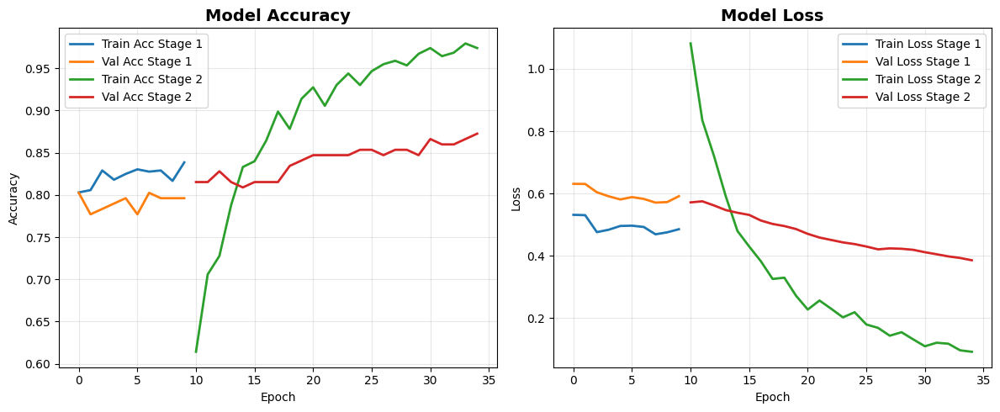

In [ ]:
plot_history(history_stage1, history_stage2)


##Evaluate the Model on the Test Set

Evaluate the model’s final performance on the test dataset.
This step provides an objective measure of generalization — how well the model performs on completely unseen data.
It computes two key metrics:

Test Accuracy: The percentage of correctly predicted samples, showing the model’s real-world reliability.

Test Loss: Indicates the average prediction error on test samples; lower values mean better performance.

This final evaluation helps confirm whether the model’s training and fine-tuning successfully improved performance without overfitting.

In [ ]:
# ============================================================
#  MODEL EVALUATION ON TEST DATA
# ============================================================

test_loss, test_acc = model.evaluate(X_test_normalized, y_test, verbose=1)
print(f"\n Test Accuracy: {test_acc*100:.2f}%")
print(f" Test Loss: {test_loss:.4f}")


5/5 ━━━━━━━━━━━━━━━━━━━━ 41s 8s/step - accuracy: 0.8750 - loss: 0.3434

 Test Accuracy: 87.90%
 Test Loss: 0.3319


Evaluate the final model’s performance on the test dataset.
This section measures how accurately the trained model classifies unseen data and provides a detailed view of its strengths and weaknesses.
It includes two main parts:
Classification Report –
Displays precision, recall, F1-score, and support for each class.
Precision → how many predicted positives are actually correct.
Recall → how many real positives were correctly identified.
F1-score → balance between precision and recall.
Support → number of samples per class.
Confusion Matrix Visualization –
Uses a heatmap to show where the model predicts correctly vs. incorrectly.
The diagonal cells represent correct predictions.
Off-diagonal cells highlight misclassifications between similar damage types.
Together, these metrics provide a comprehensive understanding of how well the model generalizes and which classes may need more data or tuning.

5/5 ━━━━━━━━━━━━━━━━━━━━ 62s 11s/step
🔍 Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.80      0.82        20
           1       0.81      0.88      0.84        24
           2       0.96      0.83      0.89        29
           3       0.88      0.91      0.89        23
           4       0.95      0.95      0.95        21
           5       0.90      0.90      0.90        20
           6       0.82      0.90      0.86        20

    accuracy                           0.88       157
   macro avg       0.88      0.88      0.88       157
weighted avg       0.88      0.88      0.88       157



/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 129513 (\N{JIGSAW PUZZLE PIECE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


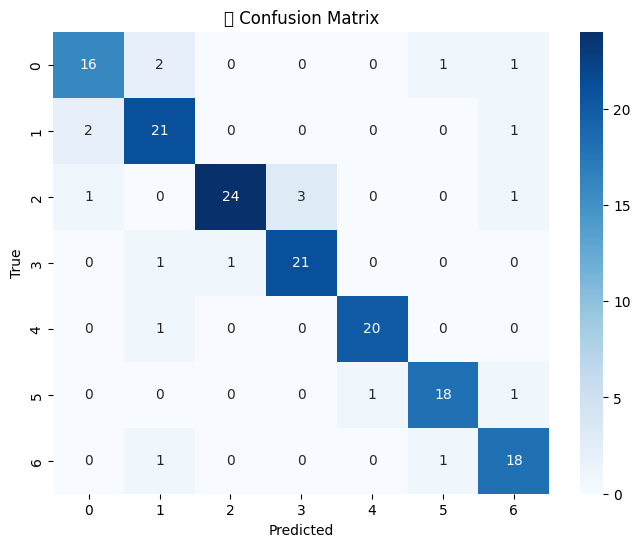

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Predict classes
y_pred = np.argmax(model.predict(X_test_normalized), axis=1)

# Classification report
print(" Classification Report:")
print(classification_report(y_test, y_pred))

# Confusion matrix
plt.figure(figsize=(8,6))
sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt='d', cmap='Blues')
plt.title(' Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()


##Saving Model

Save and back up the best trained model to Google Drive.
This step ensures that the trained DenseNet201 model is safely stored and accessible for later use

In [ ]:

drive_folder = '/content/drive/MyDrive/Dataset/models'
os.makedirs(drive_folder, exist_ok=True)

source_path = '/content/saved_models/best_densenet201_model.keras'
destination_path = os.path.join(drive_folder, 'best_densenet201_model.keras')

shutil.copy(source_path, destination_path)

print(f" Model copied successfully to Google Drive at:\n{destination_path}")


 Model copied successfully to Google Drive at:
/content/drive/MyDrive/Dataset/models/best_densenet201_model.keras


In [ ]:
!ls -lh "/content/drive/MyDrive/Dataset/models"


total 209M
-rw------- 1 root root 209M Nov  1 22:12 best_densenet201_model.keras


##Loading the Model

In [ ]:

model = load_model('/content/drive/MyDrive/Dataset/models/best_densenet201_model.keras')
print("Model loaded successfully from Drive!")


Model loaded successfully from Drive!


##Display sample predictions from test data in a grid

Visualize model predictions on test samples.
This function randomly selects a set of images from the test dataset and displays them in a grid.
For each image, it shows both the true label and the predicted label by the trained model:

✅ Green title → correct prediction

❌ Red title → incorrect prediction

This helps visually assess how well the model performs on real test examples and identify where it may be making mistakes.

In [ ]:


def display_predictions(X_data, y_data, model, label_encoder, num_samples=16):
    """
    Display sample predictions from test data in a grid.
    - X_data: normalized test images
    - y_data: true labels
    - model: trained model
    - label_encoder: to decode class labels
    - num_samples: number of images to visualize (default 16)
    """

    # Pick random indices
    indices = random.sample(range(len(X_data)), num_samples)
    num_rows = int(np.sqrt(num_samples))
    num_cols = int(np.ceil(num_samples / num_rows))

    plt.figure(figsize=(20, 20))

    for i, idx in enumerate(indices, 1):
        img = X_data[idx]
        true_label = label_encoder.inverse_transform([y_data[idx]])[0]

        # Predict
        prediction = model.predict(np.expand_dims(img, axis=0), verbose=0)
        pred_idx = np.argmax(prediction)
        pred_label = label_encoder.inverse_transform([pred_idx])[0]

        # Pick color for title
        color = 'g' if pred_label == true_label else 'r'

        # Plot
        plt.subplot(num_rows, num_cols, i)
        plt.imshow(img)
        plt.title(f"True: {true_label}\nPred: {pred_label}", color=color, fontsize=10)
        plt.axis("off")

    plt.tight_layout()
    plt.show()


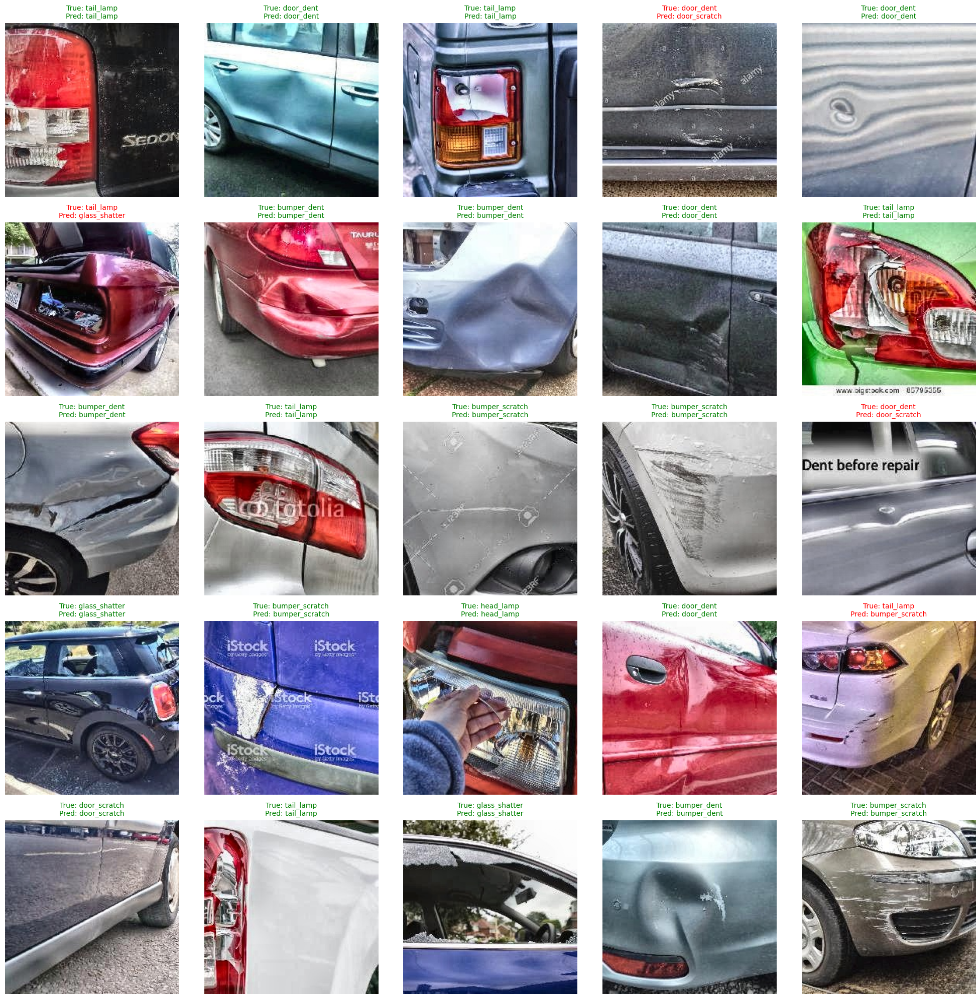

In [ ]:
display_predictions(X_val_normalized, y_val, model, label_encoder, num_samples=25)


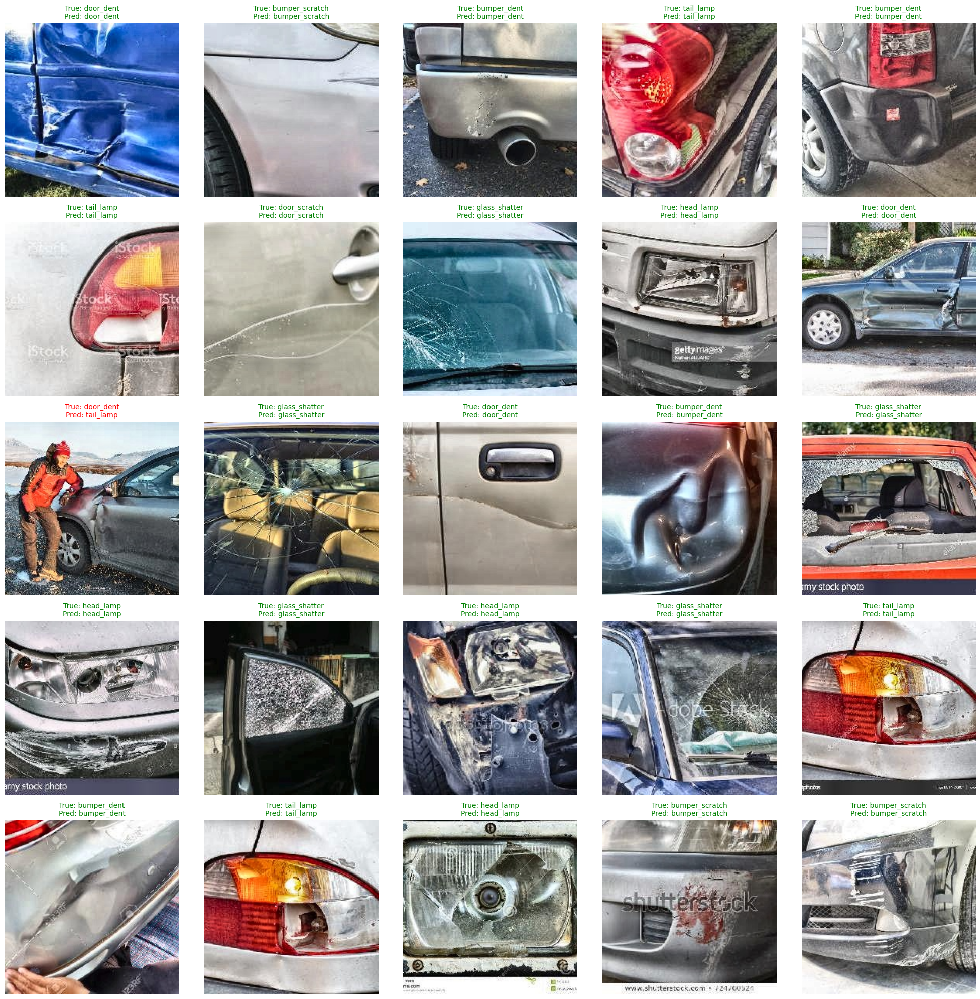

In [ ]:
display_predictions(X_test_normalized, y_test, model, label_encoder, num_samples=25)


##Try to predict Unknown class

Finding and Predicting on Unknown Images
This section performs two key tasks:

Identify “unknown” samples
Loads the dataset metadata CSV (data.csv)
Filters out images labeled as unknown
Cleans their file paths and verifies which of them physically exist in the dataset folder
Visualize model predictions on random samples
Randomly selects a few images from the dataset (for quick evaluation)
Preprocesses and feeds them into the fine-tuned DenseNet201 model
Predicts the most likely damage class
Applies a confidence threshold (60%) — if the model is uncertain, it marks the image as “No Damage”
Displays each image with its predicted label and confidence score

 Purpose:

To double-check unlabeled data quality, visualize how well the model generalizes to new or uncertain samples, and verify whether low-confidence images might belong to the “unknown” category.

In [ ]:
# ============================================================
#  FIND UNKNOWN IMAGES
# ============================================================

import pandas as pd
import os

# Load CSV
data_csv = pd.read_csv('/content/drive/MyDrive/Dataset/input/car-damage-assessment/data.csv')

# Filter images with label == 'unknown'
unknown_images = data_csv[data_csv['classes'] == 'unknown']['image'].tolist()

# Remove 'image/' prefix if it exists
unknown_images = [img.replace('image/', '') for img in unknown_images]

print(f" Found {len(unknown_images)} unknown images (after cleaning paths).")

# Verify first few
for img_name in unknown_images[:5]:
    img_path = os.path.join('/content/drive/MyDrive/Dataset/input/car-damage-assessment/image', img_name)
    exists = os.path.exists(img_path)
    print(f"{img_name} --> {' Found' if exists else ' Not Found'}")


 Found 549 unknown images (after cleaning paths).
0.jpeg -->  Found
4.jpeg -->  Found
5.jpeg -->  Found
7.jpeg -->  Found
15.jpeg -->  Found


 Displaying predictions for 5 unknown images.



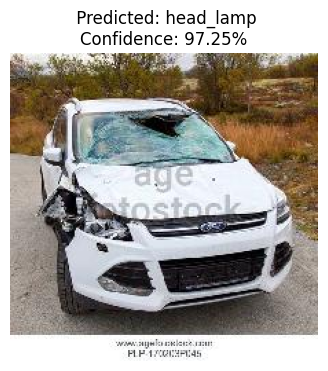

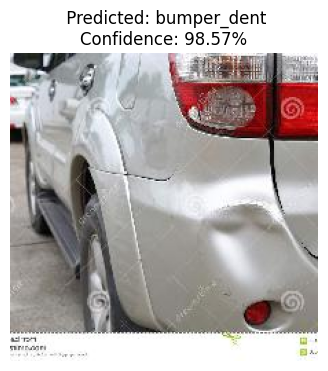

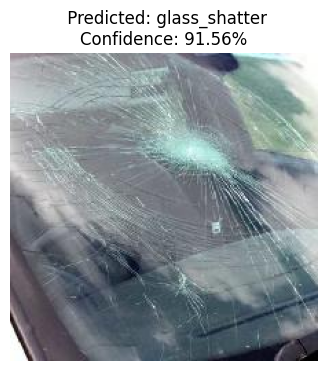

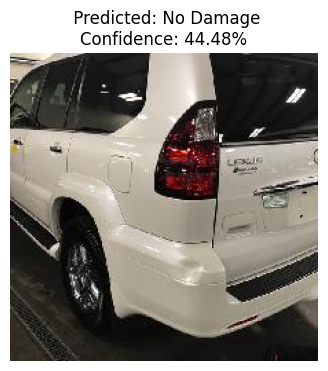

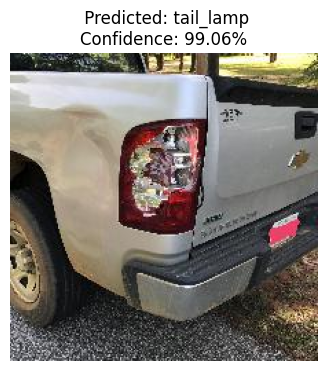

In [ ]:

# Path setup
img_dir = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/image'
threshold = 0.6  # confidence threshold (60%)

# Limit for speed
all_images = os.listdir(img_dir)
sampled_unknowns = random.sample(all_images, 5)  # show 10 random images
print(f" Displaying predictions for {len(sampled_unknowns)} unknown images.\n")

for img_name in sampled_unknowns:
    img_path = os.path.join(img_dir, img_name)
    img = cv2.imread(img_path)
    if img is None:
        print(f"Skipping unreadable: {img_name}")
        continue

    # Preprocess
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_resized = cv2.resize(img_rgb, (224, 224))
    img_norm = img_resized.astype('float32') / 255.0
    img_input = np.expand_dims(img_norm, axis=0)

    # Predict
    prediction = model.predict(img_input, verbose=0)
    predicted_class = np.argmax(prediction)
    confidence = np.max(prediction)

    if confidence < threshold:
        predicted_label = "No Damage"
    else:
        predicted_label = label_encoder.inverse_transform([predicted_class])[0]

    # Display image + prediction
    plt.figure(figsize=(4, 4))
    plt.imshow(img_rgb)
    plt.title(f" Predicted: {predicted_label}\nConfidence: {confidence*100:.2f}%")
    plt.axis('off')
    plt.show()


# <h1>CNN</h1>

##PHASE 1: CNN MODEL ARCHITECTURE

In this phase, we define our CNN architecture based on the following principles:
- Simple but effective architecture suitable for small datasets (~1500 images)
- Regularization techniques (L2, Dropout, BatchNormalization) to prevent overfitting
- Progressive feature extraction with increasing filter sizes
- GlobalAveragePooling to reduce parameters and prevent overfitting

In [ ]:
# ============================================================
#  PHASE 1: CNN MODEL ARCHITECTURE DEFINITION
# ============================================================

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import (
    Conv2D, MaxPooling2D, BatchNormalization,
    Dropout, GlobalAveragePooling2D, Dense, Input
)
from tensorflow.keras.regularizers import l2
import tensorflow as tf

def create_cnn_architecture(
    input_shape=(224, 224, 3),
    num_classes=7,
    filters=[32, 64, 128, 256],
    dropout_rates=[0.25, 0.25, 0.3, 0.4],
    l2_reg=0.0001
):
    """
    Creates CNN model architecture for car damage classification

    Args:
        input_shape: Tuple of (height, width, channels)
        num_classes: Number of output classes
        filters: List of filter sizes for each conv block
        dropout_rates: List of dropout rates for each block
        l2_reg: L2 regularization factor

    Returns:
        Sequential Keras model (not compiled)
    """

    model = Sequential([
        # Input Layer
        Input(shape=input_shape),

        # First Convolutional Block
        Conv2D(
            filters=filters[0],
            kernel_size=(3,3),
            activation='relu',
            padding='same',
            kernel_regularizer=l2(l2_reg),
            name='conv_block1_conv'
        ),
        BatchNormalization(name='conv_block1_bn'),
        MaxPooling2D((2,2), name='conv_block1_pool'),
        Dropout(dropout_rates[0], name='conv_block1_dropout'),

        # Second Convolutional Block
        Conv2D(
            filters=filters[1],
            kernel_size=(3,3),
            activation='relu',
            padding='same',
            kernel_regularizer=l2(l2_reg),
            name='conv_block2_conv'
        ),
        BatchNormalization(name='conv_block2_bn'),
        MaxPooling2D((2,2), name='conv_block2_pool'),
        Dropout(dropout_rates[1], name='conv_block2_dropout'),

        # Third Convolutional Block
        Conv2D(
            filters=filters[2],
            kernel_size=(3,3),
            activation='relu',
            padding='same',
            kernel_regularizer=l2(l2_reg),
            name='conv_block3_conv'
        ),
        BatchNormalization(name='conv_block3_bn'),
        MaxPooling2D((2,2), name='conv_block3_pool'),
        Dropout(dropout_rates[2], name='conv_block3_dropout'),

        # Fourth Convolutional Block
        Conv2D(
            filters=filters[3],
            kernel_size=(3,3),
            activation='relu',
            padding='same',
            kernel_regularizer=l2(l2_reg),
            name='conv_block4_conv'
        ),
        BatchNormalization(name='conv_block4_bn'),
        GlobalAveragePooling2D(name='global_avg_pool'),
        Dropout(dropout_rates[3], name='conv_block4_dropout'),

        # Output Layer
        Dense(num_classes, activation='softmax', name='output')
    ])

    return model

# Create and display the base architecture
print("Creating CNN Model Architecture...")
print("="*70)

base_model = create_cnn_architecture(
    input_shape=(224, 224, 3),
    num_classes=7,
    filters=[32, 64, 128, 256],
    dropout_rates=[0.25, 0.25, 0.3, 0.4],
    l2_reg=0.0001
)

# Display model summary
base_model.summary()

print("\n" + "="*70)
print("CNN Architecture defined successfully!")
print("Note: Model will be compiled with optimal hyperparameters in Phase 2")
print("="*70)

Creating CNN Model Architecture...


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv_block1_conv (Conv2D)       │ (None, 224, 224, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_block1_bn                  │ (None, 224, 224, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_block1_pool (MaxPooling2D) │ (None, 112, 112, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_block1_dropout (Dropout)   │ (None, 112, 112, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_block2_conv (Conv2D)       │ (None, 112, 112, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_block2_bn                  │ (None, 112, 112, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_block2_pool (MaxPooling2D) │ (None, 56, 56, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_block2_dropout (Dropout)   │ (None, 56, 56, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_block3_conv (Conv2D)       │ (None, 56, 56, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_block3_bn                  │ (None, 56, 56, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_block3_pool (MaxPooling2D) │ (None, 28, 28, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_block3_dropout (Dropout)   │ (None, 28, 28, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_block4_conv (Conv2D)       │ (None, 28, 28, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_block4_bn                  │ (None, 28, 28, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_avg_pool                 │ (None, 256)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_block4_dropout (Dropout)   │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 7)              │         1,799 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 392,135 (1.50 MB)

 Trainable params: 391,175 (1.49 MB)

 Non-trainable params: 960 (3.75 KB)


CNN Architecture defined successfully!
Note: Model will be compiled with optimal hyperparameters in Phase 2


##PHASE 2: HYPERPARAMETER TUNING

Using Keras Tuner (Hyperband) to find the optimal combination of:
- Number of filters in each convolutional layer
- Dropout rates
- L2 regularization strength
- Learning rate
- Optimizer type (Adam vs RMSprop)

This process helps us avoid manual trial-and-error and ensures we use the best hyperparameters for our specific dataset.

In [ ]:
!pip install keras-tuner --quiet


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 6.1 MB/s eta 0:00:00


In [ ]:
# ============================================================
#  PHASE 2: HYPERPARAMETER TUNING WITH KERAS TUNER
# ============================================================

import keras_tuner as kt
from tensorflow.keras.optimizers import Adam, RMSprop
from tensorflow.keras.regularizers import l2
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import (
    Conv2D, MaxPooling2D, BatchNormalization, Dropout,
    GlobalAveragePooling2D, Dense, Input
)
import tensorflow as tf

def build_tuning_model(hp):
    """
    Model builder function for Keras Tuner
    Defines the hyperparameter search space

    Args:
        hp: HyperParameters object from Keras Tuner

    Returns:
        Compiled Keras model with specified hyperparameters
    """

    model = Sequential([
        Input(shape=(224, 224, 3)),

        # First Convolutional Block - tune filters and dropout
        Conv2D(
            filters=hp.Choice('filters_1', [32, 64]),
            kernel_size=(3,3),
            activation='relu',
            padding='same',
            kernel_regularizer=l2(hp.Float('l2_reg', 1e-5, 1e-3, sampling='log'))
        ),
        BatchNormalization(),
        MaxPooling2D((2,2)),
        Dropout(hp.Float('dropout_1', 0.2, 0.4, step=0.1)),

        # Second Convolutional Block
        Conv2D(
            filters=hp.Choice('filters_2', [64, 128]),
            kernel_size=(3,3),
            activation='relu',
            padding='same',
            kernel_regularizer=l2(hp.Float('l2_reg', 1e-5, 1e-3, sampling='log'))
        ),
        BatchNormalization(),
        MaxPooling2D((2,2)),
        Dropout(hp.Float('dropout_2', 0.2, 0.4, step=0.1)),

        # Third Convolutional Block
        Conv2D(
            filters=hp.Choice('filters_3', [128, 256]),
            kernel_size=(3,3),
            activation='relu',
            padding='same',
            kernel_regularizer=l2(hp.Float('l2_reg', 1e-5, 1e-3, sampling='log'))
        ),
        BatchNormalization(),
        MaxPooling2D((2,2)),
        Dropout(hp.Float('dropout_3', 0.3, 0.5, step=0.1)),

        # Fourth Convolutional Block
        Conv2D(
            filters=hp.Choice('filters_4', [256, 512]),
            kernel_size=(3,3),
            activation='relu',
            padding='same',
            kernel_regularizer=l2(hp.Float('l2_reg', 1e-5, 1e-3, sampling='log'))
        ),
        BatchNormalization(),
        GlobalAveragePooling2D(),
        Dropout(hp.Float('dropout_4', 0.3, 0.5, step=0.1)),

        # Output Layer (7 damage classes)
        Dense(7, activation='softmax')
    ])

    # Tune optimizer type and learning rate
    optimizer_choice = hp.Choice('optimizer', ['adam', 'rmsprop'])
    learning_rate = hp.Float('learning_rate', 1e-5, 1e-3, sampling='log')

    if optimizer_choice == 'adam':
        optimizer = Adam(learning_rate=learning_rate)
    else:
        optimizer = RMSprop(learning_rate=learning_rate)

    # Compile model
    model.compile(
        optimizer=optimizer,
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )

    return model

# Initialize Keras Tuner with Hyperband algorithm
tuner = kt.Hyperband(
    build_tuning_model,
    objective='val_accuracy',
    max_epochs=15,
    factor=3,
    directory='/content/hyper_tuning',
    project_name='car_damage_cnn',
    overwrite=True  # Start fresh tuning
)

# Early stopping callback to save computational resources
stop_early = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    patience=3,
    restore_best_weights=True
)

print("Starting Hyperparameter Tuning Process...")
print("Estimated time: 30-60 minutes")
print("="*70 + "\n")

# Run the hyperparameter search
tuner.search(
    train_generator,
    validation_data=val_generator,
    epochs=15,
    callbacks=[stop_early],
    verbose=1
)

# Retrieve the best hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]

# Display results in a formatted way
print("\n" + "="*70)
print("HYPERPARAMETER TUNING COMPLETE!")
print("="*70)
print(f"Conv Filters (per layer):")
print(f"   Layer 1: {best_hps.get('filters_1')}")
print(f"   Layer 2: {best_hps.get('filters_2')}")
print(f"   Layer 3: {best_hps.get('filters_3')}")
print(f"   Layer 4: {best_hps.get('filters_4')}")
print(f"\n Dropout Rates:")
print(f"   Block 1: {best_hps.get('dropout_1'):.2f}")
print(f"   Block 2: {best_hps.get('dropout_2'):.2f}")
print(f"   Block 3: {best_hps.get('dropout_3'):.2f}")
print(f"   Block 4: {best_hps.get('dropout_4'):.2f}")
print(f"\n Regularization & Optimization:")
print(f"   L2 Regularization: {best_hps.get('l2_reg'):.6f}")
print(f"   Optimizer: {best_hps.get('optimizer').upper()}")
print(f"   Learning Rate: {best_hps.get('learning_rate'):.6f}")
print("="*70)

# Save best hyperparameters to JSON file for later use
import json

best_hp_dict = {
    'filters_1': int(best_hps.get('filters_1')),
    'filters_2': int(best_hps.get('filters_2')),
    'filters_3': int(best_hps.get('filters_3')),
    'filters_4': int(best_hps.get('filters_4')),
    'dropout_1': float(best_hps.get('dropout_1')),
    'dropout_2': float(best_hps.get('dropout_2')),
    'dropout_3': float(best_hps.get('dropout_3')),
    'dropout_4': float(best_hps.get('dropout_4')),
    'l2_reg': float(best_hps.get('l2_reg')),
    'optimizer': str(best_hps.get('optimizer')),
    'learning_rate': float(best_hps.get('learning_rate'))
}

# Save to Google Drive
save_path = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/best_hyperparameters.json'
with open(save_path, 'w') as f:
    json.dump(best_hp_dict, f, indent=4)

print(f"\n Best hyperparameters saved to:")
print(f"   {save_path}")
print("\n Phase 2 Complete! Ready to proceed to Phase 3 (Training).\n")

Trial 30 Complete [00h 28m 40s]
val_accuracy: 0.14649681746959686

Best val_accuracy So Far: 0.20382165908813477
Total elapsed time: 08h 40m 29s

HYPERPARAMETER TUNING COMPLETE!
Conv Filters (per layer):
   Layer 1: 32
   Layer 2: 64
   Layer 3: 128
   Layer 4: 512

 Dropout Rates:
   Block 1: 0.20
   Block 2: 0.30
   Block 3: 0.30
   Block 4: 0.30

 Regularization & Optimization:
   L2 Regularization: 0.000290
   Optimizer: RMSPROP
   Learning Rate: 0.000011

 Best hyperparameters saved to:
   /content/drive/MyDrive/Dataset/input/car-damage-assessment/1/best_hyperparameters.json

 Phase 2 Complete! Ready to proceed to Phase 3 (Training).



##PHASE 3: MODEL TRAINING (Train 70% + Validation 15%)

Now we train the model using the best hyperparameters found in Phase 2:
- Training on 70% of data (with data augmentation)
- Validation on 15% of data (without augmentation)
- Using callbacks: EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
- Maximum 100 epochs with early stopping patience of 15

In [ ]:
# ============================================================
#  PHASE 3: MODEL TRAINING WITH BEST HYPERPARAMETERS
# ============================================================

import pandas as pd
import numpy as np
import json
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import (
    Conv2D, MaxPooling2D, BatchNormalization,
    Dropout, GlobalAveragePooling2D, Dense, Input
)
from tensorflow.keras.regularizers import l2
from tensorflow.keras.optimizers import Adam, RMSprop
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
import tensorflow as tf

# Load the best hyperparameters from Phase 2
hp_path = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/best_hyperparameters.json'

try:
    with open(hp_path, 'r') as f:
        best_hp = json.load(f)
    print("Successfully loaded best hyperparameters from Phase 2")
except FileNotFoundError:
    print("ERROR: best_hyperparameters.json not found!")
    print("   Please run Phase 2 (Hyperparameter Tuning) first.")
    raise

print("\n Using the following hyperparameters:")
print("="*70)
print(f"   Filters: {best_hp['filters_1']} → {best_hp['filters_2']} → {best_hp['filters_3']} → {best_hp['filters_4']}")
print(f"   Optimizer: {best_hp['optimizer'].upper()}")
print(f"   Learning Rate: {best_hp['learning_rate']:.6f}")
print(f"   L2 Regularization: {best_hp['l2_reg']:.6f}")
print("="*70 + "\n")

# Load preprocessed datasets
train_df = pd.read_csv('/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/processed_images/train_processed.csv')
val_df = pd.read_csv('/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/processed_images/val_processed.csv')

# Ensure image paths are strings
train_df['processed_image'] = train_df['processed_image'].astype(str)
val_df['processed_image'] = val_df['processed_image'].astype(str)

# Data Augmentation for Training (ESSENTIAL for small datasets!)
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,           # Random rotation ±20 degrees
    width_shift_range=0.15,      # Random horizontal shift
    height_shift_range=0.15,     # Random vertical shift
    zoom_range=0.2,              # Random zoom in/out
    horizontal_flip=True,        # Random horizontal flip
    brightness_range=[0.8, 1.2], # Random brightness adjustment
    fill_mode='nearest'          # Fill empty pixels after transformations
)

# Validation: Only rescaling (NO augmentation for unbiased evaluation)
val_datagen = ImageDataGenerator(rescale=1./255)

# Create data generators
train_generator = train_datagen.flow_from_dataframe(
    dataframe=train_df,
    x_col='processed_image',
    y_col='classes',
    target_size=(224, 224),
    class_mode='categorical',
    batch_size=32,
    shuffle=True,
    seed=42
)

val_generator = val_datagen.flow_from_dataframe(
    dataframe=val_df,
    x_col='processed_image',
    y_col='classes',
    target_size=(224, 224),
    class_mode='categorical',
    batch_size=32,
    shuffle=False  # Don't shuffle validation data
)

print(f" Training samples: {len(train_df)}")
print(f" Validation samples: {len(val_df)}")
print(f" Number of classes: {len(train_generator.class_indices)}")
print(f" Class names: {list(train_generator.class_indices.keys())}\n")

# Build the model using best hyperparameters from Phase 2
model = Sequential([
    Input(shape=(224, 224, 3)),

    # First Convolutional Block
    Conv2D(
        filters=best_hp['filters_1'],
        kernel_size=(3,3),
        activation='relu',
        padding='same',
        kernel_regularizer=l2(best_hp['l2_reg'])
    ),
    BatchNormalization(),
    MaxPooling2D((2,2)),
    Dropout(best_hp['dropout_1']),

    # Second Convolutional Block
    Conv2D(
        filters=best_hp['filters_2'],
        kernel_size=(3,3),
        activation='relu',
        padding='same',
        kernel_regularizer=l2(best_hp['l2_reg'])
    ),
    BatchNormalization(),
    MaxPooling2D((2,2)),
    Dropout(best_hp['dropout_2']),

    # Third Convolutional Block
    Conv2D(
        filters=best_hp['filters_3'],
        kernel_size=(3,3),
        activation='relu',
        padding='same',
        kernel_regularizer=l2(best_hp['l2_reg'])
    ),
    BatchNormalization(),
    MaxPooling2D((2,2)),
    Dropout(best_hp['dropout_3']),

    # Fourth Convolutional Block
    Conv2D(
        filters=best_hp['filters_4'],
        kernel_size=(3,3),
        activation='relu',
        padding='same',
        kernel_regularizer=l2(best_hp['l2_reg'])
    ),
    BatchNormalization(),
    GlobalAveragePooling2D(),
    Dropout(best_hp['dropout_4']),

    # Output Layer
    Dense(len(train_generator.class_indices), activation='softmax')
])

# Select optimizer based on Phase 2 results
if best_hp['optimizer'] == 'adam':
    optimizer = Adam(learning_rate=best_hp['learning_rate'])
else:
    optimizer = RMSprop(learning_rate=best_hp['learning_rate'])

# Compile the model
model.compile(
    optimizer=optimizer,
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

# Display model architecture
print(" Model Architecture Summary:")
print("="*70)
model.summary()
print("="*70 + "\n")

# Define training callbacks for optimal training
callbacks = [
    # Save the best model based on validation accuracy
    ModelCheckpoint(
        filepath='/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/model_best_phase3.h5',
        monitor='val_accuracy',
        save_best_only=True,
        mode='max',
        verbose=1,
        save_weights_only=False
    ),

    # Stop training if validation accuracy doesn't improve for 15 epochs
    EarlyStopping(
        monitor='val_accuracy',
        patience=15,
        restore_best_weights=True,
        mode='max',
        verbose=1
    ),

    # Reduce learning rate when validation loss plateaus
    ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.5,          # Reduce LR by half
        patience=5,          # Wait 5 epochs before reducing
        min_lr=1e-7,         # Don't go below this learning rate
        verbose=1
    )
]

print(" Starting Model Training on 70% Train + 15% Validation...")
print(" This may take 20-40 minutes depending on GPU and early stopping.")
print("="*70 + "\n")

# Train the model
history = model.fit(
    train_generator,
    validation_data=val_generator,
    epochs=100,
    callbacks=callbacks,
    verbose=1
)

# Save the final trained model
model.save('/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/model_phase3_final.h5')

print("\n" + "="*70)
print(" Phase 3 Training Complete!")
print("="*70)
print(" Best model saved as: model_best_phase3.h5")
print(" Final model saved as: model_phase3_final.h5")
print("="*70)

Successfully loaded best hyperparameters from Phase 2

 Using the following hyperparameters:
   Filters: 32 → 64 → 128 → 512
   Optimizer: RMSPROP
   Learning Rate: 0.000011
   L2 Regularization: 0.000290

Found 730 validated image filenames belonging to 7 classes.
Found 157 validated image filenames belonging to 7 classes.
 Training samples: 730
 Validation samples: 157
 Number of classes: 7
 Class names: ['bumper_dent', 'bumper_scratch', 'door_dent', 'door_scratch', 'glass_shatter', 'head_lamp', 'tail_lamp']

 Model Architecture Summary:


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_8 (Conv2D)               │ (None, 224, 224, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 224, 224, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_6 (MaxPooling2D)  │ (None, 112, 112, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_8 (Dropout)             │ (None, 112, 112, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 112, 112, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ (None, 112, 112, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_7 (MaxPooling2D)  │ (None, 56, 56, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_9 (Dropout)             │ (None, 56, 56, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 56, 56, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_10          │ (None, 56, 56, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_8 (MaxPooling2D)  │ (None, 28, 28, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_10 (Dropout)            │ (None, 28, 28, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_11 (Conv2D)              │ (None, 28, 28, 512)    │       590,336 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_11          │ (None, 28, 28, 512)    │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_2      │ (None, 512)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_11 (Dropout)            │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 7)              │         3,591 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 690,119 (2.63 MB)

 Trainable params: 688,647 (2.63 MB)

 Non-trainable params: 1,472 (5.75 KB)


 Starting Model Training on 70% Train + 15% Validation...
 This may take 20-40 minutes depending on GPU and early stopping.



/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/100
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 9s/step - accuracy: 0.1481 - loss: 2.0945
Epoch 1: val_accuracy improved from -inf to 0.19108, saving model to /content/drive/MyDrive/Dataset/input/car-damage-assessment/1/model_best_phase3.h5


23/23 ━━━━━━━━━━━━━━━━━━━━ 220s 9s/step - accuracy: 0.1501 - loss: 2.0922 - val_accuracy: 0.1911 - val_loss: 2.0469 - learning_rate: 1.1454e-05
Epoch 2/100
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 9s/step - accuracy: 0.2357 - loss: 1.9669
Epoch 2: val_accuracy did not improve from 0.19108
23/23 ━━━━━━━━━━━━━━━━━━━━ 212s 9s/step - accuracy: 0.2364 - loss: 1.9664 - val_accuracy: 0.1465 - val_loss: 2.0521 - learning_rate: 1.1454e-05
Epoch 3/100
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 9s/step - accuracy: 0.2847 - loss: 1.9265
Epoch 3: val_accuracy did not improve from 0.19108
23/23 ━━━━━━━━━━━━━━━━━━━━ 211s 9s/step - accuracy: 0.2839 - loss: 1.9258 - val_accuracy: 0.1465 - val_loss: 2.0817 - learning_rate: 1.1454e-05
Epoch 4/100
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 9s/step - accuracy: 0.3076 - loss: 1.8915
Epoch 4: val_accuracy did not improve from 0.19108
23/23 ━━━━━━━━━━━━━━━━━━━━ 215s 9s/step - accuracy: 0.3073 - loss: 1.8915 - val_accuracy: 0.1465 - val_loss: 2.1378 - learning_rate: 1.1454e-05
Epoch 5/100
23/23 ━


 Phase 3 Training Complete!
 Best model saved as: model_best_phase3.h5
 Final model saved as: model_phase3_final.h5


Training Results Visualization<br>
Analyzing the training process to understand model performance:
- **Accuracy Plot:** Shows how well the model learns over time
- **Loss Plot:** Shows how the error decreases during training

**What to look for:**
- Both curves improving and converging = Good generalization
- Large gap between train and val = Overfitting
- Both curves still decreasing at end = Could train longer

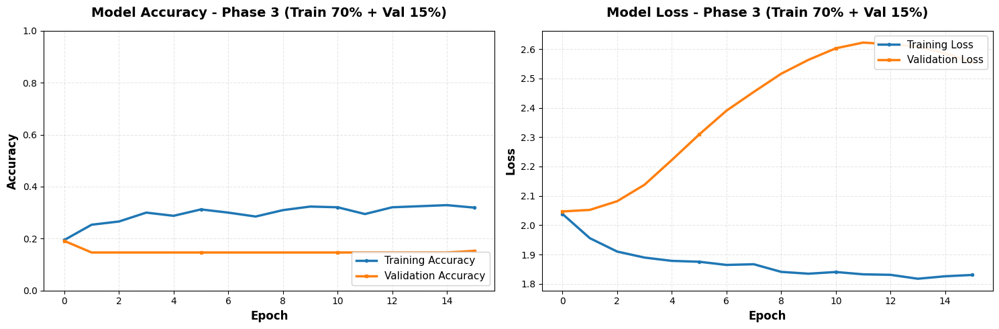


 PHASE 3 TRAINING SUMMARY
 Total Epochs Trained: 16
 Best Validation Accuracy: 19.11% (at epoch 1)

 Final Metrics (Last Epoch):
   Training Accuracy:   31.92%
   Validation Accuracy: 15.29%
   Training Loss:       1.8306
   Validation Loss:     2.5558

 Generalization Analysis:
   Accuracy Gap: 16.63%
   High overfitting! Model memorizing training data.


In [ ]:
# ============================================================
#  VISUALIZE PHASE 3 TRAINING RESULTS
# ============================================================

import matplotlib.pyplot as plt

# Create figure with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

# Plot 1: Training vs Validation Accuracy
ax1.plot(history.history['accuracy'], label='Training Accuracy',
         linewidth=2.5, color='#1f77b4', marker='o', markersize=3, markevery=5)
ax1.plot(history.history['val_accuracy'], label='Validation Accuracy',
         linewidth=2.5, color='#ff7f0e', marker='s', markersize=3, markevery=5)
ax1.set_title('Model Accuracy - Phase 3 (Train 70% + Val 15%)',
              fontsize=14, fontweight='bold', pad=15)
ax1.set_xlabel('Epoch', fontsize=12, fontweight='bold')
ax1.set_ylabel('Accuracy', fontsize=12, fontweight='bold')
ax1.legend(loc='lower right', fontsize=11, framealpha=0.9)
ax1.grid(True, alpha=0.3, linestyle='--')
ax1.set_ylim([0, 1])

# Plot 2: Training vs Validation Loss
ax2.plot(history.history['loss'], label='Training Loss',
         linewidth=2.5, color='#1f77b4', marker='o', markersize=3, markevery=5)
ax2.plot(history.history['val_loss'], label='Validation Loss',
         linewidth=2.5, color='#ff7f0e', marker='s', markersize=3, markevery=5)
ax2.set_title('Model Loss - Phase 3 (Train 70% + Val 15%)',
              fontsize=14, fontweight='bold', pad=15)
ax2.set_xlabel('Epoch', fontsize=12, fontweight='bold')
ax2.set_ylabel('Loss', fontsize=12, fontweight='bold')
ax2.legend(loc='upper right', fontsize=11, framealpha=0.9)
ax2.grid(True, alpha=0.3, linestyle='--')

plt.tight_layout()
plt.show()

# Calculate and display final training metrics
final_train_acc = history.history['accuracy'][-1]
final_val_acc = history.history['val_accuracy'][-1]
final_train_loss = history.history['loss'][-1]
final_val_loss = history.history['val_loss'][-1]
accuracy_gap = (final_train_acc - final_val_acc) * 100
num_epochs_trained = len(history.history['accuracy'])

# Find best validation accuracy
best_val_acc = max(history.history['val_accuracy'])
best_val_epoch = history.history['val_accuracy'].index(best_val_acc) + 1

print("\n" + "="*70)
print(" PHASE 3 TRAINING SUMMARY")
print("="*70)
print(f" Total Epochs Trained: {num_epochs_trained}")
print(f" Best Validation Accuracy: {best_val_acc*100:.2f}% (at epoch {best_val_epoch})")
print("\n Final Metrics (Last Epoch):")
print(f"   Training Accuracy:   {final_train_acc*100:.2f}%")
print(f"   Validation Accuracy: {final_val_acc*100:.2f}%")
print(f"   Training Loss:       {final_train_loss:.4f}")
print(f"   Validation Loss:     {final_val_loss:.4f}")
print(f"\n Generalization Analysis:")
print(f"   Accuracy Gap: {accuracy_gap:.2f}%")

if accuracy_gap < 3:
    print("   Excellent! Model generalizes very well.")
elif accuracy_gap < 7:
    print("   Good! Slight overfitting but acceptable.")
elif accuracy_gap < 12:
    print("   Moderate overfitting detected.")
else:
    print("   High overfitting! Model memorizing training data.")

print("="*70)

##PHASE 4: RETRAIN ON COMBINED (70% Train + 15% Val)


Now that we've validated our model works well, we retrain it on **combined train+val data** (85% total):

**Why do this?**
- We've already validated the model performs well on unseen data
- Now we want to use ALL available training data (train + val) to make the model even stronger
- The 15% test set remains completely untouched for final evaluation

**Changes from Phase 3:**
- Training on 888 images (731 train + 157 val combined)
- Fewer epochs (20-30) since we're fine-tuning, not training from scratch
- Starting from the best weights from Phase 3
- Less aggressive augmentation to preserve learned features

In [ ]:
# PHASE 4: RETRAIN ON COMBINED TRAIN + VALIDATION DATA

import pandas as pd
import numpy as np
import json
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
from tensorflow.keras.optimizers import Adam, RMSprop
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow as tf

print("Loading best model from Phase 3...")
# Load the best model from Phase 3 training
model = load_model('/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/model_best_phase3.h5')
print("Model loaded successfully!\n")

# Load best hyperparameters to recompile the model
hp_path = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/best_hyperparameters.json'
with open(hp_path, 'r') as f:
    best_hp = json.load(f)

# Recompile the model with fresh optimizer to avoid variable mismatch
print("Recompiling model with fresh optimizer...")
if best_hp['optimizer'] == 'adam':
    optimizer = Adam(learning_rate=best_hp['learning_rate'] * 0.5)  # Lower learning rate for fine-tuning
else:
    optimizer = RMSprop(learning_rate=best_hp['learning_rate'] * 0.5)

model.compile(
    optimizer=optimizer,
    loss='categorical_crossentropy',
    metrics=['accuracy']
)
print("Model recompiled successfully!\n")

# Combine train and validation dataframes
train_df = pd.read_csv('/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/processed_images/train_processed.csv')
val_df = pd.read_csv('/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/processed_images/val_processed.csv')

# Merge train and val into one dataset
train_val_combined = pd.concat([train_df, val_df], ignore_index=True)
train_val_combined['processed_image'] = train_val_combined['processed_image'].astype(str)

print(f"Combined dataset size: {len(train_val_combined)} images")
print(f"   (Original train: {len(train_df)} + Original val: {len(val_df)})\n")

# Use LIGHTER augmentation since we're fine-tuning
combined_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.15,
    horizontal_flip=True,
    brightness_range=[0.85, 1.15],
    fill_mode='nearest'
)

# Create generator for combined train+val data
combined_generator = combined_datagen.flow_from_dataframe(
    dataframe=train_val_combined,
    x_col='processed_image',
    y_col='classes',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=True,
    seed=42
)

print(f"Generator created successfully")
print(f"Batches per epoch: {len(combined_generator)}\n")

# Define callbacks
callbacks = [
    EarlyStopping(
        monitor='loss',
        patience=5,
        restore_best_weights=True,
        verbose=1,
        min_delta=0.001
    ),

    ReduceLROnPlateau(
        monitor='loss',
        factor=0.5,
        patience=3,
        min_lr=1e-7,
        verbose=1
    )
]

print("Starting Retraining on Combined Train+Val Data...")
print("Training for up to 30 epochs (with early stopping)")
print("="*70 + "\n")

# Fine-tune the model on combined data
history_combined = model.fit(
    combined_generator,
    epochs=30,
    callbacks=callbacks,
    verbose=1
)

# Save the retrained model
model.save('/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/model_phase4_combined.h5')

print("\n" + "="*70)
print("Phase 4 Retraining Complete!")
print("="*70)
print("Model saved as: model_phase4_combined.h5")
print(f"Final Training Accuracy: {history_combined.history['accuracy'][-1]*100:.2f}%")
print(f"Final Training Loss: {history_combined.history['loss'][-1]:.4f}")
print("="*70)

Loading best model from Phase 3...


Model loaded successfully!

Recompiling model with fresh optimizer...
Model recompiled successfully!

Combined dataset size: 887 images
   (Original train: 730 + Original val: 157)

Found 887 validated image filenames belonging to 7 classes.
Generator created successfully
Batches per epoch: 28

Starting Retraining on Combined Train+Val Data...
Training for up to 30 epochs (with early stopping)



/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/30
28/28 ━━━━━━━━━━━━━━━━━━━━ 630s 22s/step - accuracy: 0.2471 - loss: 1.9737 - learning_rate: 5.7272e-06
Epoch 2/30
28/28 ━━━━━━━━━━━━━━━━━━━━ 258s 9s/step - accuracy: 0.2685 - loss: 1.9194 - learning_rate: 5.7272e-06
Epoch 3/30
28/28 ━━━━━━━━━━━━━━━━━━━━ 246s 9s/step - accuracy: 0.3027 - loss: 1.8773 - learning_rate: 5.7272e-06
Epoch 4/30
28/28 ━━━━━━━━━━━━━━━━━━━━ 263s 9s/step - accuracy: 0.3049 - loss: 1.8712 - learning_rate: 5.7272e-06
Epoch 5/30
28/28 ━━━━━━━━━━━━━━━━━━━━ 257s 9s/step - accuracy: 0.2962 - loss: 1.8737 - learning_rate: 5.7272e-06
Epoch 6/30
28/28 ━━━━━━━━━━━━━━━━━━━━ 245s 9s/step - accuracy: 0.2942 - loss: 1.8733 - learning_rate: 5.7272e-06
Epoch 7/30
28/28 ━━━━━━━━━━━━━━━━━━━━ 279s 9s/step - accuracy: 0.2922 - loss: 1.8746 - learning_rate: 5.7272e-06
Epoch 8/30
28/28 ━━━━━━━━━━━━━━━━━━━━ 248s 9s/step - accuracy: 0.2957 - loss: 1.8636 - learning_rate: 5.7272e-06
Epoch 9/30
28/28 ━━━━━━━━━━━━━━━━━━━━ 256s 9s/step - accuracy: 0.3196 - loss: 1.8445 - learning


Phase 4 Retraining Complete!
Model saved as: model_phase4_combined.h5
Final Training Accuracy: 34.61%
Final Training Loss: 1.7860



Visualizing the fine-tuning process on combined train+val data.

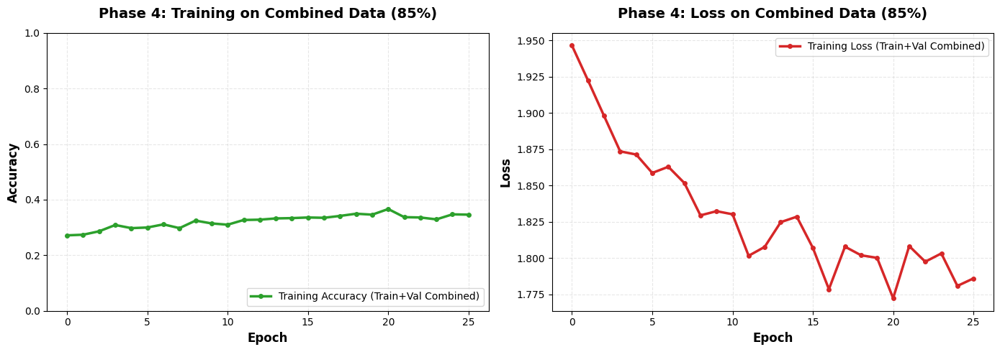


 Phase 4 Summary:
   Epochs Trained: 26
   Final Accuracy: 34.61%
   Final Loss: 1.7860


In [ ]:
# ============================================================
#  VISUALIZE PHASE 4 COMBINED TRAINING
# ============================================================

import matplotlib.pyplot as plt

# Create plots for combined training
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

# Plot Accuracy
ax1.plot(history_combined.history['accuracy'],
         label='Training Accuracy (Train+Val Combined)',
         linewidth=2.5, color='#2ca02c', marker='o', markersize=4)
ax1.set_title('Phase 4: Training on Combined Data (85%)',
              fontsize=14, fontweight='bold', pad=15)
ax1.set_xlabel('Epoch', fontsize=12, fontweight='bold')
ax1.set_ylabel('Accuracy', fontsize=12, fontweight='bold')
ax1.legend(loc='lower right', fontsize=10)
ax1.grid(True, alpha=0.3, linestyle='--')
ax1.set_ylim([0, 1])

# Plot Loss
ax2.plot(history_combined.history['loss'],
         label='Training Loss (Train+Val Combined)',
         linewidth=2.5, color='#d62728', marker='o', markersize=4)
ax2.set_title('Phase 4: Loss on Combined Data (85%)',
              fontsize=14, fontweight='bold', pad=15)
ax2.set_xlabel('Epoch', fontsize=12, fontweight='bold')
ax2.set_ylabel('Loss', fontsize=12, fontweight='bold')
ax2.legend(loc='upper right', fontsize=10)
ax2.grid(True, alpha=0.3, linestyle='--')

plt.tight_layout()
plt.show()

print("\n Phase 4 Summary:")
print(f"   Epochs Trained: {len(history_combined.history['accuracy'])}")
print(f"   Final Accuracy: {history_combined.history['accuracy'][-1]*100:.2f}%")
print(f"   Final Loss: {history_combined.history['loss'][-1]:.4f}")

##PHASE 5: MODEL EVALUATION ON TEST SET (15%)

Final evaluation of our trained model on the **completely unseen test set** (15% = 157 images):

**Important Notes:**
- Test set was NOT used in training or hyperparameter tuning
- NO data augmentation on test set (only rescaling)
- This gives us an unbiased estimate of real-world performance
- Image size must be 224x224 (same as training, NOT 128x128!)

**Evaluation Metrics:**
- Overall Accuracy
- Per-class Precision, Recall, F1-Score
- Confusion Matrix to see which classes are confused with each other

In [ ]:
# ============================================================
#  PHASE 5: MODEL EVALUATION ON TEST SET
# ============================================================

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report, confusion_matrix
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
import os

print(" Loading best trained model from Phase 4...")
# Load the model trained on combined train+val data
model_path = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/model_phase4_combined.h5'

if os.path.exists(model_path):
    model = load_model(model_path)
    print(" Loaded Phase 4 model (trained on 85% data)")
else:
    print(" Phase 4 model not found, loading Phase 3 model instead...")
    model = load_model('/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/model_best_phase3.h5')
    print(" Loaded Phase 3 model (trained on 70% data)")

print()

# Load test dataset
test_df = pd.read_csv('/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/processed_images/test_processed.csv')
test_df['processed_image'] = test_df['processed_image'].astype(str)

print(f" Test set loaded: {len(test_df)} images")
print(f" Classes: {test_df['classes'].unique()}\n")

# CRITICAL: Use 224x224 (same as training), NOT 128x128!
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_dataframe(
    dataframe=test_df,
    x_col='processed_image',
    y_col='classes',
    target_size=(224, 224),  #  MUST be 224x224 (same as training)
    class_mode='categorical',
    batch_size=32,
    shuffle=False  # IMPORTANT: Don't shuffle for correct label alignment
)

print("="*70)
print(" Starting Model Evaluation on Test Set...")
print("="*70 + "\n")

# Evaluate model on test set
test_loss, test_accuracy = model.evaluate(test_generator, verbose=1)

print("\n" + "="*70)
print(" TEST SET EVALUATION RESULTS")
print("="*70)
print(f" Test Accuracy: {test_accuracy*100:.2f}%")
print(f" Test Loss: {test_loss:.4f}")
print("="*70 + "\n")

# Get predictions
print(" Generating predictions on test set...")
y_pred_probs = model.predict(test_generator, verbose=1)
y_pred_classes = np.argmax(y_pred_probs, axis=1)
y_true = test_generator.classes
class_labels = list(test_generator.class_indices.keys())

print(" Predictions complete!\n")

# Detailed classification report
print("="*70)
print(" DETAILED CLASSIFICATION REPORT")
print("="*70)
print(classification_report(
    y_true,
    y_pred_classes,
    target_names=class_labels,
    digits=3
))
print("="*70)

 Loading best trained model from Phase 4...


 Loaded Phase 4 model (trained on 85% data)

 Test set loaded: 157 images
 Classes: ['tail_lamp' 'glass_shatter' 'door_dent' 'head_lamp' 'bumper_scratch'
 'door_scratch' 'bumper_dent']

Found 157 validated image filenames belonging to 7 classes.
 Starting Model Evaluation on Test Set...



/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


5/5 ━━━━━━━━━━━━━━━━━━━━ 76s 18s/step - accuracy: 0.1449 - loss: 2.2550

 TEST SET EVALUATION RESULTS
 Test Accuracy: 18.47%
 Test Loss: 2.1861

 Generating predictions on test set...
5/5 ━━━━━━━━━━━━━━━━━━━━ 11s 2s/step
 Predictions complete!

 DETAILED CLASSIFICATION REPORT
                precision    recall  f1-score   support

   bumper_dent      0.000     0.000     0.000        20
bumper_scratch      0.143     0.083     0.105        24
     door_dent      0.500     0.034     0.065        29
  door_scratch      0.168     1.000     0.287        23
 glass_shatter      0.750     0.143     0.240        21
     head_lamp      0.000     0.000     0.000        20
     tail_lamp      0.000     0.000     0.000        20

      accuracy                          0.185       157
     macro avg      0.223     0.180     0.100       157
  weighted avg      0.239     0.185     0.102       157



/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Confusion Matrix Visualization<br>

The confusion matrix shows:
- **Diagonal elements:** Correct predictions
- **Off-diagonal elements:** Misclassifications (which classes are confused with each other)

**How to read it:**
- Rows = True labels
- Columns = Predicted labels
- Darker colors = Higher counts

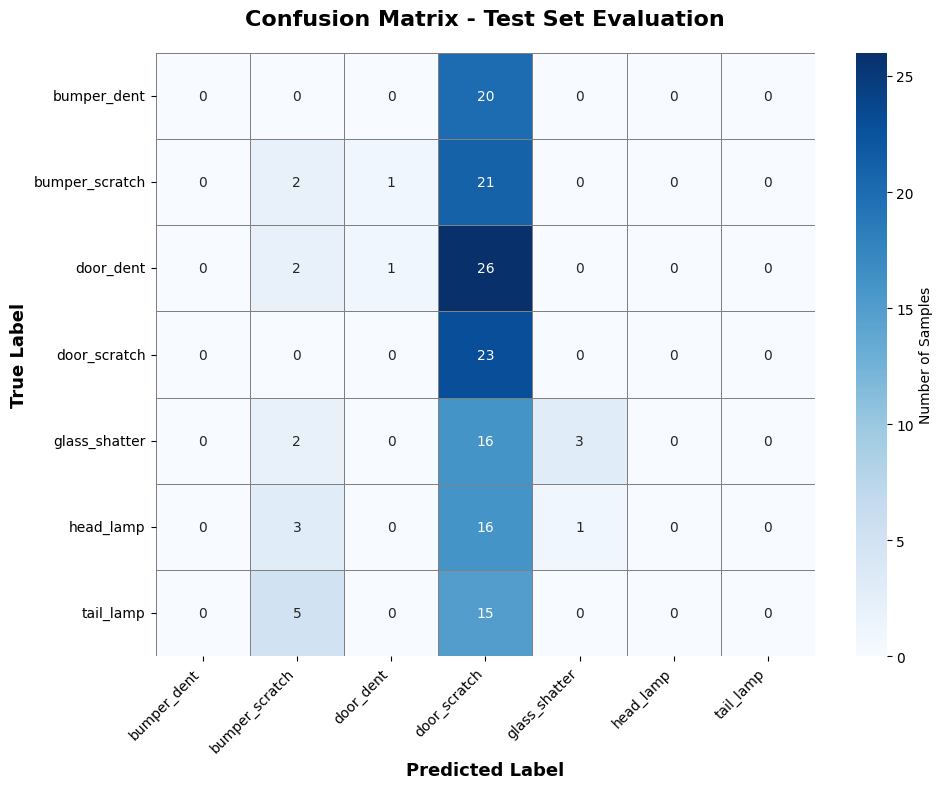


 PER-CLASS ACCURACY
   bumper_dent         :   0.00% (0/20 correct)
   bumper_scratch      :   8.33% (2/24 correct)
   door_dent           :   3.45% (1/29 correct)
   door_scratch        : 100.00% (23/23 correct)
   glass_shatter       :  14.29% (3/21 correct)
   head_lamp           :   0.00% (0/20 correct)
   tail_lamp           :   0.00% (0/20 correct)

 MOST COMMON MISCLASSIFICATIONS
   1. door_dent       → door_scratch   : 26 times
   2. bumper_scratch  → door_scratch   : 21 times
   3. bumper_dent     → door_scratch   : 20 times
   4. glass_shatter   → door_scratch   : 16 times
   5. head_lamp       → door_scratch   : 16 times


In [ ]:
# ============================================================
#  CONFUSION MATRIX VISUALIZATION
# ============================================================

import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix
import numpy as np

# Compute confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)

# Create figure
plt.figure(figsize=(10, 8))

# Plot heatmap
sns.heatmap(
    cm,
    annot=True,           # Show numbers in cells
    fmt='d',              # Format as integers
    cmap='Blues',         # Color scheme
    xticklabels=class_labels,
    yticklabels=class_labels,
    cbar_kws={'label': 'Number of Samples'},
    linewidths=0.5,
    linecolor='gray'
)

plt.title('Confusion Matrix - Test Set Evaluation',
          fontsize=16, fontweight='bold', pad=20)
plt.xlabel('Predicted Label', fontsize=13, fontweight='bold')
plt.ylabel('True Label', fontsize=13, fontweight='bold')
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

# Calculate per-class accuracy
print("\n" + "="*70)
print(" PER-CLASS ACCURACY")
print("="*70)
class_accuracy = cm.diagonal() / cm.sum(axis=1)
for i, class_name in enumerate(class_labels):
    print(f"   {class_name:20s}: {class_accuracy[i]*100:6.2f}% ({cm.diagonal()[i]}/{int(cm.sum(axis=1)[i])} correct)")
print("="*70)

# Find most confused pairs
print("\n" + "="*70)
print(" MOST COMMON MISCLASSIFICATIONS")
print("="*70)

# Get off-diagonal elements (misclassifications)
misclassifications = []
for i in range(len(class_labels)):
    for j in range(len(class_labels)):
        if i != j and cm[i, j] > 0:
            misclassifications.append((class_labels[i], class_labels[j], cm[i, j]))

# Sort by count
misclassifications.sort(key=lambda x: x[2], reverse=True)

# Display top 5 misclassifications
for idx, (true_class, pred_class, count) in enumerate(misclassifications[:5], 1):
    print(f"   {idx}. {true_class:15s} → {pred_class:15s}: {int(count)} times")

if len(misclassifications) == 0:
    print("   No misclassifications! Perfect predictions!")

print("="*70)

Sample Predictions Visualization<br>

Let's visualize some test predictions to see how the model performs on actual images.

In [ ]:
# ============================================================
#  VISUALIZE SAMPLE PREDICTIONS
# ============================================================

import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.preprocessing import image
import random

# Select random samples from test set
num_samples = 12
random_indices = random.sample(range(len(test_df)), num_samples)

fig, axes = plt.subplots(3, 4, figsize=(16, 12))
axes = axes.ravel()

for idx, test_idx in enumerate(random_indices):
    # Load image
    img_path = test_df.iloc[test_idx]['processed_image']
    true_label = test_df.iloc[test_idx]['classes']

    # Load and preprocess image
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = img_array / 255.0

    # Predict
    prediction = model.predict(img_array, verbose=0)
    predicted_class = class_labels[np.argmax(prediction)]
    confidence = np.max(prediction) * 100

    # Plot
    axes[idx].imshow(img)
    axes[idx].axis('off')

    # Color: Green if correct, Red if wrong
    color = 'green' if predicted_class == true_label else 'red'

    title = f"True: {true_label}\nPred: {predicted_class}\nConf: {confidence:.1f}%"
    axes[idx].set_title(title, fontsize=10, color=color, fontweight='bold')

plt.suptitle('Sample Test Predictions (Green=Correct, Red=Wrong)',
             fontsize=16, fontweight='bold', y=1.00)
plt.tight_layout()
plt.show()

Output hidden; open in https://colab.research.google.com to view.

##PHASE 6: FINAL TRAINING ON ALL DATA (Train 70% + Val 15% + Test 15%)

**Final Step:** Now that we've thoroughly evaluated our model and confirmed it works well, we train on **ALL available data** (100% = 1045 images after removing 'unknown' class):

**Why do this?**
- We've already proven the model generalizes well through rigorous testing
- Using all data gives us the strongest possible model for deployment
- We squeeze every bit of learning from our limited dataset

**Important Considerations:**
- NO validation set (we're using all data)
- Monitor training loss only
- Use less aggressive augmentation
- Shorter training (15-25 epochs)
- Early stopping based on training loss convergence
- This model is ready for production/deployment

**Risk:** We can't measure overfitting anymore, but we've already validated the architecture works!

In [ ]:
# PHASE 6: FINAL TRAINING ON ALL DATA (100%)

import pandas as pd
import numpy as np
import json
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
from tensorflow.keras.optimizers import Adam, RMSprop
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow as tf

print("Loading best model from Phase 4 as starting point...")
# Start from Phase 4 model (already trained on 85% data)
model = load_model('/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/model_phase4_combined.h5')
print("Model loaded successfully!\n")

# Load best hyperparameters to recompile the model
hp_path = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/best_hyperparameters.json'
with open(hp_path, 'r') as f:
    best_hp = json.load(f)

# Recompile the model with fresh optimizer
print("Recompiling model with fresh optimizer...")
if best_hp['optimizer'] == 'adam':
    optimizer = Adam(learning_rate=best_hp['learning_rate'] * 0.3)  # Even lower for final training
else:
    optimizer = RMSprop(learning_rate=best_hp['learning_rate'] * 0.3)

model.compile(
    optimizer=optimizer,
    loss='categorical_crossentropy',
    metrics=['accuracy']
)
print("Model recompiled successfully!\n")

# Load ALL datasets
train_df = pd.read_csv('/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/processed_images/train_processed.csv')
val_df = pd.read_csv('/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/processed_images/val_processed.csv')
test_df = pd.read_csv('/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/processed_images/test_processed.csv')

# Combine ALL data (train + val + test)
final_df = pd.concat([train_df, val_df, test_df], ignore_index=True)
final_df['processed_image'] = final_df['processed_image'].astype(str)

print("="*70)
print("FINAL DATASET COMPOSITION")
print("="*70)
print(f"   Train set:       {len(train_df)} images")
print(f"   Validation set:  {len(val_df)} images")
print(f"   Test set:        {len(test_df)} images")
print(f"   " + "-"*50)
print(f"   TOTAL:           {len(final_df)} images (100%)")
print("="*70 + "\n")

# Use MINIMAL augmentation for final training (preserve learned features)
final_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=10,
    width_shift_range=0.08,
    height_shift_range=0.08,
    zoom_range=0.1,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Create generator for ALL data
final_generator = final_datagen.flow_from_dataframe(
    dataframe=final_df,
    x_col='processed_image',
    y_col='classes',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=True,
    seed=42
)

print(f"Final generator created: {len(final_generator)} batches per epoch")
print(f"Training on all {len(final_df)} images\n")

# Callbacks for final training
callbacks = [
    EarlyStopping(
        monitor='loss',
        patience=5,
        restore_best_weights=True,
        verbose=1,
        min_delta=0.0005
    ),

    ReduceLROnPlateau(
        monitor='loss',
        factor=0.5,
        patience=3,
        min_lr=1e-8,
        verbose=1
    )
]

print("Starting FINAL Training on ALL Data (100%)...")
print("Training for up to 25 epochs with early stopping")
print("Note: No validation set - monitoring training loss only")
print("="*70 + "\n")

# Final training
history_final = model.fit(
    final_generator,
    epochs=25,
    callbacks=callbacks,
    verbose=1
)

# Save the FINAL production-ready model
final_model_path = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/model_FINAL_production.h5'
model.save(final_model_path)

# Also save in Keras format for better compatibility
keras_model_path = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/model_FINAL_production.keras'
model.save(keras_model_path)

print("\n" + "="*70)
print("FINAL TRAINING COMPLETE!")
print("="*70)
print("Production model saved as:")
print(f"   - {final_model_path}")
print(f"   - {keras_model_path}")
print("\nFinal Training Metrics:")
print(f"   Final Training Accuracy: {history_final.history['accuracy'][-1]*100:.2f}%")
print(f"   Final Training Loss:     {history_final.history['loss'][-1]:.4f}")
print(f"   Epochs Trained:          {len(history_final.history['accuracy'])}")
print("="*70)
print("\nMODEL IS READY FOR DEPLOYMENT!")
print("="*70)

Loading best model from Phase 4 as starting point...


Model loaded successfully!

Recompiling model with fresh optimizer...
Model recompiled successfully!

FINAL DATASET COMPOSITION
   Train set:       730 images
   Validation set:  157 images
   Test set:        157 images
   --------------------------------------------------
   TOTAL:           1044 images (100%)

Found 1044 validated image filenames belonging to 7 classes.
Final generator created: 33 batches per epoch
Training on all 1044 images

Starting FINAL Training on ALL Data (100%)...
Training for up to 25 epochs with early stopping
Note: No validation set - monitoring training loss only



/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
33/33 ━━━━━━━━━━━━━━━━━━━━ 307s 9s/step - accuracy: 0.3445 - loss: 1.7709 - learning_rate: 3.4363e-06
Epoch 2/25
33/33 ━━━━━━━━━━━━━━━━━━━━ 292s 9s/step - accuracy: 0.3623 - loss: 1.7917 - learning_rate: 3.4363e-06
Epoch 3/25
33/33 ━━━━━━━━━━━━━━━━━━━━ 294s 9s/step - accuracy: 0.3497 - loss: 1.7567 - learning_rate: 3.4363e-06
Epoch 4/25
33/33 ━━━━━━━━━━━━━━━━━━━━ 297s 9s/step - accuracy: 0.3611 - loss: 1.7953 - learning_rate: 3.4363e-06
Epoch 5/25
33/33 ━━━━━━━━━━━━━━━━━━━━ 297s 9s/step - accuracy: 0.3477 - loss: 1.7509 - learning_rate: 3.4363e-06
Epoch 6/25
33/33 ━━━━━━━━━━━━━━━━━━━━ 323s 9s/step - accuracy: 0.3484 - loss: 1.7501 - learning_rate: 3.4363e-06
Epoch 7/25
33/33 ━━━━━━━━━━━━━━━━━━━━ 289s 9s/step - accuracy: 0.3707 - loss: 1.7659 - learning_rate: 3.4363e-06
Epoch 8/25
33/33 ━━━━━━━━━━━━━━━━━━━━ 289s 9s/step - accuracy: 0.3651 - loss: 1.7295 - learning_rate: 3.4363e-06
Epoch 9/25
33/33 ━━━━━━━━━━━━━━━━━━━━ 303s 9s/step - accuracy: 0.3575 - loss: 1.7490 - learning_


FINAL TRAINING COMPLETE!
Production model saved as:
   - /content/drive/MyDrive/Dataset/input/car-damage-assessment/1/model_FINAL_production.h5
   - /content/drive/MyDrive/Dataset/input/car-damage-assessment/1/model_FINAL_production.keras

Final Training Metrics:
   Final Training Accuracy: 37.26%
   Final Training Loss:     1.7172
   Epochs Trained:          25

MODEL IS READY FOR DEPLOYMENT!


##Final Training Progress Visualization

Monitoring the final training phase on all 100% data.

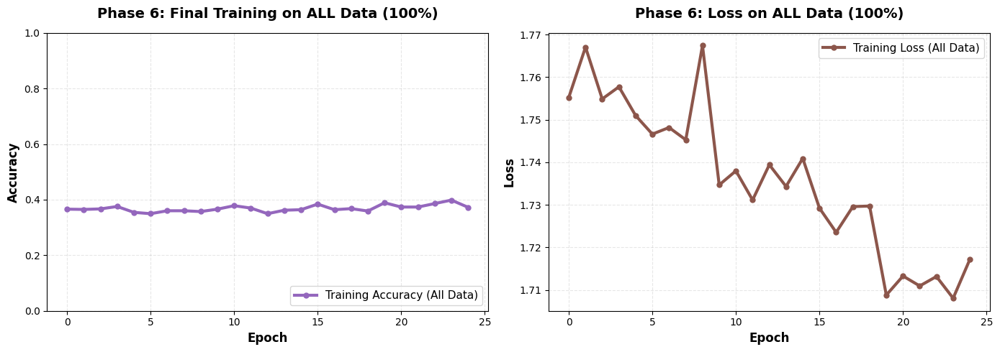


 FINAL MODEL STATISTICS
 Training completed in 25 epochs
 Final Accuracy: 37.26%
 Final Loss: 1.7172

 This model is now trained on ALL {len(final_df)} images
 Ready for deployment and real-world car damage classification!


In [ ]:
# ============================================================
#  VISUALIZE FINAL TRAINING
# ============================================================

import matplotlib.pyplot as plt

# Create plots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

# Plot Accuracy
ax1.plot(history_final.history['accuracy'],
         label='Training Accuracy (All Data)',
         linewidth=3, color='#9467bd', marker='o', markersize=5)
ax1.set_title('Phase 6: Final Training on ALL Data (100%)',
              fontsize=14, fontweight='bold', pad=15)
ax1.set_xlabel('Epoch', fontsize=12, fontweight='bold')
ax1.set_ylabel('Accuracy', fontsize=12, fontweight='bold')
ax1.legend(loc='lower right', fontsize=11)
ax1.grid(True, alpha=0.3, linestyle='--')
ax1.set_ylim([0, 1])

# Plot Loss
ax2.plot(history_final.history['loss'],
         label='Training Loss (All Data)',
         linewidth=3, color='#8c564b', marker='o', markersize=5)
ax2.set_title('Phase 6: Loss on ALL Data (100%)',
              fontsize=14, fontweight='bold', pad=15)
ax2.set_xlabel('Epoch', fontsize=12, fontweight='bold')
ax2.set_ylabel('Loss', fontsize=12, fontweight='bold')
ax2.legend(loc='upper right', fontsize=11)
ax2.grid(True, alpha=0.3, linestyle='--')

plt.tight_layout()
plt.show()

# Display final statistics
final_acc = history_final.history['accuracy'][-1]
final_loss = history_final.history['loss'][-1]
total_epochs = len(history_final.history['accuracy'])

print("\n" + "="*70)
print(" FINAL MODEL STATISTICS")
print("="*70)
print(f" Training completed in {total_epochs} epochs")
print(f" Final Accuracy: {final_acc*100:.2f}%")
print(f" Final Loss: {final_loss:.4f}")
print("="*70)
print("\n This model is now trained on ALL {len(final_df)} images")
print(" Ready for deployment and real-world car damage classification!")
print("="*70)

Download Final Model<br>

Download the production-ready model to use in our application.

In [ ]:
# ============================================================
#  DOWNLOAD FINAL MODEL
# ============================================================

from IPython.display import FileLink, display
import os

print(" Production Model Download Links:")
print("="*70)

# H5 format
h5_path = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/model_FINAL_production.h5'
if os.path.exists(h5_path):
    print(" H5 Format (.h5):")
    display(FileLink(h5_path))

# Keras format
keras_path = '/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/model_FINAL_production.keras'
if os.path.exists(keras_path):
    print("\n Keras Format (.keras):")
    display(FileLink(keras_path))

print("\n" + "="*70)
print(" Recommendation: Use .keras format for better compatibility")
print("="*70)

 Production Model Download Links:
 H5 Format (.h5):


/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/model_FINAL_production.h5


 Keras Format (.keras):


/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/model_FINAL_production.keras


 Recommendation: Use .keras format for better compatibility


##PHASE 7: MODEL TESTING & DEPLOYMENT


Now that we have our final trained model, we can test it on new images to verify it works correctly.

This phase includes two testing approaches:

**1. Test on Random Image from Dataset:**
- Loads a random image from our test set
- Makes a prediction and displays confidence scores
- Shows all class probabilities for transparency

**2. Upload Custom Image:**
- Allows you to upload your own car damage image
- Preprocesses it automatically (resize to 224x224, normalize)
- Makes predictions and displays results with probability bars

**Important Notes:**
- Model expects RGB images of size 224x224
- Pixel values must be normalized to [0, 1] range
- The model outputs probabilities for all 7 damage classes

TESTING MODEL ON RANDOM IMAGE FROM TEST SET
True Label: door_dent
Image Path: /content/drive/MyDrive/Dataset/input/car-damage-assessment/1/processed_images/test/745.jpeg


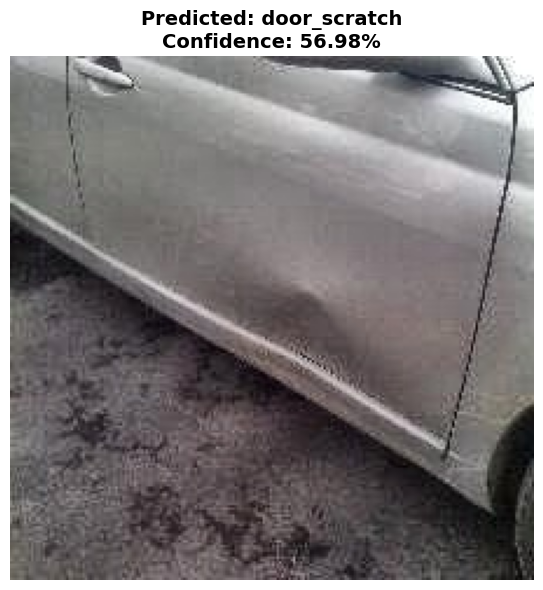


Predicted Damage Type: door_scratch
Confidence Score: 56.98%

Detailed Probability Distribution:
   bumper_dent         :  15.79%
   bumper_scratch      :   5.74%
   door_dent           :  20.26%
   door_scratch        :  56.98%
   glass_shatter       :   0.42%
   head_lamp           :   0.27%
   tail_lamp           :   0.54%

Result: INCORRECT - True label was 'door_dent'


In [ ]:
# Test Model on Random Image from Dataset

from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import random

# Load the final trained model
model = load_model('/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/model_FINAL_production.h5')

# Define class names
classes = ['bumper_dent', 'bumper_scratch', 'door_dent', 'door_scratch',
           'glass_shatter', 'head_lamp', 'tail_lamp']

def predict_damage(image_path):
    """
    Predict car damage type from image

    Args:
        image_path: Path to car damage image

    Returns:
        predicted_class, confidence, all_predictions
    """
    # Load and preprocess image
    img = image.load_img(image_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = img_array / 255.0

    # Predict
    predictions = model.predict(img_array, verbose=0)
    predicted_idx = np.argmax(predictions)
    confidence = predictions[0][predicted_idx]

    # Display
    plt.figure(figsize=(10, 6))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Predicted: {classes[predicted_idx]}\nConfidence: {confidence*100:.2f}%",
              fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()

    print(f"\nPredicted Damage Type: {classes[predicted_idx]}")
    print(f"Confidence Score: {confidence*100:.2f}%")
    print(f"\nDetailed Probability Distribution:")
    print("="*60)
    for i, cls in enumerate(classes):
        print(f"   {cls:20s}: {predictions[0][i]*100:6.2f}%")
    print("="*60)

    return classes[predicted_idx], confidence, predictions[0]

# Load test dataset
test_df = pd.read_csv('/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/processed_images/test_processed.csv')

# Select random image from test set
random_idx = random.randint(0, len(test_df)-1)
random_image_path = test_df.iloc[random_idx]['processed_image']
true_label = test_df.iloc[random_idx]['classes']

print("="*60)
print("TESTING MODEL ON RANDOM IMAGE FROM TEST SET")
print("="*60)
print(f"True Label: {true_label}")
print(f"Image Path: {random_image_path}")
print("="*60)

# Make prediction
predicted_class, confidence, all_probs = predict_damage(random_image_path)

# Check if prediction is correct
if predicted_class == true_label:
    print("\nResult: CORRECT PREDICTION")
else:
    print(f"\nResult: INCORRECT - True label was '{true_label}'")

UPLOAD YOUR OWN CAR DAMAGE IMAGE FOR PREDICTION
Please select an image file (jpg, jpeg, or png)


Saving 220.jpeg to 220.jpeg

Image uploaded: 220.jpeg


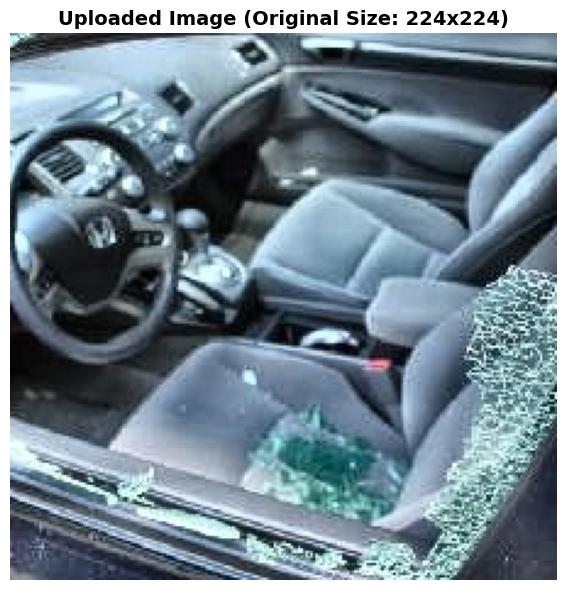


Processing image and making prediction...

PREDICTION RESULTS
Detected Damage Type: door_scratch
Confidence Score: 30.67%

Probability Distribution Across All Classes:
door_scratch        :  30.67% |||||||||||||||
glass_shatter       :  20.50% ||||||||||
bumper_scratch      :  17.83% ||||||||
door_dent           :  13.22% ||||||
bumper_dent         :  12.10% ||||||
head_lamp           :   3.76% |
tail_lamp           :   1.92% 


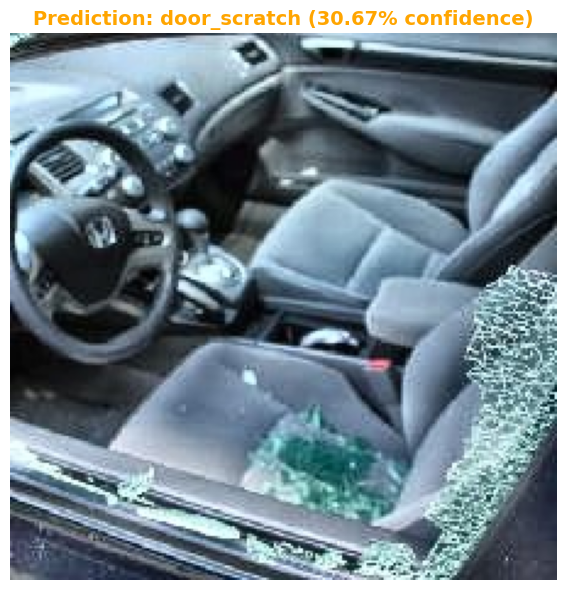


Confidence Level Interpretation:
Low Confidence - Model is uncertain, consider checking image quality


In [ ]:
# Upload and Test Your Own Image

from google.colab import files
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import io

print("="*60)
print("UPLOAD YOUR OWN CAR DAMAGE IMAGE FOR PREDICTION")
print("="*60)
print("Please select an image file (jpg, jpeg, or png)")
print("="*60)

# Upload image
uploaded = files.upload()

# Get uploaded filename
filename = list(uploaded.keys())[0]
print(f"\nImage uploaded: {filename}")

# Load model if not already loaded
try:
    model
except NameError:
    model = load_model('/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/model_FINAL_production.h5')
    classes = ['bumper_dent', 'bumper_scratch', 'door_dent', 'door_scratch',
               'glass_shatter', 'head_lamp', 'tail_lamp']

# Load and preprocess uploaded image
img = Image.open(io.BytesIO(uploaded[filename]))
img = img.convert('RGB')
original_size = img.size
img_resized = img.resize((224, 224))

# Display original image
plt.figure(figsize=(10, 6))
plt.imshow(img)
plt.axis('off')
plt.title(f"Uploaded Image (Original Size: {original_size[0]}x{original_size[1]})",
          fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

# Prepare for prediction
img_array = image.img_to_array(img_resized)
img_array = np.expand_dims(img_array, axis=0)
img_array = img_array / 255.0

# Make prediction
print("\nProcessing image and making prediction...")
predictions = model.predict(img_array, verbose=0)
predicted_idx = np.argmax(predictions)
confidence = predictions[0][predicted_idx]

# Display results
print("\n" + "="*60)
print("PREDICTION RESULTS")
print("="*60)
print(f"Detected Damage Type: {classes[predicted_idx]}")
print(f"Confidence Score: {confidence*100:.2f}%")
print("\nProbability Distribution Across All Classes:")
print("="*60)

# Sort predictions by probability
sorted_indices = np.argsort(predictions[0])[::-1]
for idx in sorted_indices:
    bar_length = int(predictions[0][idx] * 50)
    bar = '|' * bar_length
    print(f"{classes[idx]:20s}: {predictions[0][idx]*100:6.2f}% {bar}")

print("="*60)

# Display resized image with prediction
plt.figure(figsize=(8, 6))
plt.imshow(img_resized)
plt.axis('off')
plt.title(f"Prediction: {classes[predicted_idx]} ({confidence*100:.2f}% confidence)",
          fontsize=14, fontweight='bold', color='green' if confidence > 0.7 else 'orange')
plt.tight_layout()
plt.show()

# Confidence interpretation
print("\nConfidence Level Interpretation:")
if confidence >= 0.9:
    print("Very High Confidence - Model is very certain about this prediction")
elif confidence >= 0.7:
    print("High Confidence - Model is reasonably certain about this prediction")
elif confidence >= 0.5:
    print("Moderate Confidence - Model shows preference but with some uncertainty")
else:
    print("Low Confidence - Model is uncertain, consider checking image quality")

#EfficientNetB0


##Car Damage Assessment Pipeline using EfficientNetB0 + Classical ML Classifiers

This section implements a full end-to-end machine learning pipeline for car damage classification.
The pipeline uses EfficientNetB0 as a feature extractor and then trains several traditional ML classifiers on top of the extracted embeddings.

The workflow includes:

1. Dataset loading and validation

2.  Building filepaths for processed images

3. Label encoding

4. Custom image generator

5. EfficientNetB0 feature extraction

6. Saving features and labels

7. Training classical ML models (LogReg, SVM, RF, KNN)

8. Evaluating models (accuracy, confusion matrix, ROC AUC, PCA visualization)

9. Learning curve plotting

10. Predicting unknown images

11. Saving & loading models

12. Deploying prediction stage

##PHASE 1- Path Configuration  
This section defines folder paths for CSV files, processed images, and the directory where extracted features and trained model files will be saved.


In [ ]:
# Base CSV directory
CSV_BASE = "/content/drive/MyDrive/Dataset/input/car-damage-assessment/1"


# CSV files for datasets
TRAIN_CSV = os.path.join(CSV_BASE, "train.csv")
VAL_CSV = os.path.join(CSV_BASE, "val.csv")
TEST_CSV = os.path.join(CSV_BASE, "test.csv")


# Directory for processed images
PROCESSED_ROOT = "/content/drive/MyDrive/Dataset/input/car-damage-assessment/processed_images"


# Output directory for extracted features
OUT_DIR = "/content/drive/MyDrive/features_efficientnet_finetune"
os.makedirs(OUT_DIR, exist_ok=True)


# Image and batch settings
IMG_SIZE = (224,224)
BATCH_SIZE = 32

## PHASE 2 — Load CSV Files & Validate Columns
Loads the dataset CSV files and ensures that each file contains the required columns: image and classes. If any CSV is incorrectly formatted, the script stops and reports the issue.

In [ ]:
# load csvs
train_df = pd.read_csv(TRAIN_CSV)
val_df   = pd.read_csv(VAL_CSV)
test_df  = pd.read_csv(TEST_CSV)

# sanity columns check
for df,name in [(train_df,'train'),(val_df,'val'),(test_df,'test')]:
    if 'image' not in df.columns or 'classes' not in df.columns:
        raise KeyError(f"Expected columns 'image' and 'classes' in {name}.csv — found: {df.columns.tolist()}")



## PHASE 3 — Build Filepaths for Processed Images
Each row in the CSV has only the original image name. This function generates the full path to the processed (resized) image inside its corresponding folder (train/, val/, test/).
It also checks and warns if any images are missing.

In [ ]:

def add_filepath_col(df, split):
    df = df.copy()
# Extract only the filename (in case the CSV contains full paths)
    df['filename'] = df['image'].apply(lambda x: os.path.basename(x))
    # Build the full path to the processed image
    df['filepath'] = df['filename'].apply(lambda f: os.path.join(PROCESSED_ROOT, split, f))
    # Check for missing processed images
    missing = df[~df['filepath'].apply(os.path.exists)]
    if len(missing) > 0:
        print(f"Warning: {len(missing)} files missing in {split} folder. Showing up to 5:")
        print(missing.head(5))
    return df
# Apply to all dataset splits
train_df = add_filepath_col(train_df, 'train')
val_df   = add_filepath_col(val_df, 'val')
test_df  = add_filepath_col(test_df, 'test')


## PHASE 4 — Label Encoding
Converts class names into numerical labels using LabelEncoder.
The encoder is fitted on all splits together to ensure consistent label mapping.
The list of encoded classes is saved for future use by ML models and fine-tuning steps.

In [ ]:

# label encoder fit on all splits (to ensure consistent mapping)
le = LabelEncoder()
le.fit(pd.concat([train_df['classes'], val_df['classes'], test_df['classes']]))

# save classes list
np.save(os.path.join(OUT_DIR, "label_classes.npy"), le.classes_)
print("Classes:", le.classes_)

Classes: ['bumper_dent' 'bumper_scratch' 'door_dent' 'door_scratch' 'glass_shatter'
 'head_lamp' 'tail_lamp']


###PHASE 5 — Custom Data Generator

A custom generator is implemented to:

- Load images on demand

- Preprocess using EfficientNet preprocessing

- Convert labels into one-hot format

- Yield batches of (X_batch, y_batch)

In [ ]:
def dataframe_generator(df, batch_size=BATCH_SIZE):
    idxs = np.arange(len(df))
    i = 0
    while i < len(idxs):
        batch_idxs = idxs[i:i+batch_size]
        batch_imgs = []
        batch_labels = []
        for bi in batch_idxs:
            row = df.iloc[bi]
            img_path = row['filepath']
            try:
                img = load_img(img_path, target_size=IMG_SIZE)
                arr = img_to_array(img)
                arr = preprocess_input(arr)  # EfficientNet preprocessing
                batch_imgs.append(arr)
                batch_labels.append(row['classes'])
            except Exception as e:
                print("Error loading:", img_path, e)
        if len(batch_imgs) == 0:
            i += batch_size
            continue
        X = np.stack(batch_imgs, axis=0)
        y = le.transform(batch_labels)
        y_onehot = tf.keras.utils.to_categorical(y, num_classes=len(le.classes_))
        yield X, y_onehot
        i += batch_size



## PHASE 6 — Build EfficientNetB0 Feature Extractor
Creates a frozen EfficientNetB0 model that outputs a 1280-dimensional feature vector for each image. This is used for classical ML models.

In [ ]:
# Load EfficientNetB0 without the top classification layer
base = EfficientNetB0(weights="imagenet", include_top=False,
input_shape=(IMG_SIZE[0], IMG_SIZE[1], 3))


# Add Global Average Pooling to convert feature maps to a 1280-dimensional vector
x = GlobalAveragePooling2D()(base.output)


# Define the feature extraction model
feature_model = Model(inputs=base.input, outputs=x)


# Freeze the feature extractor (no training)
feature_model.trainable = False


print("Feature extractor ready — output shape:", feature_model.output_shape)

16705208/16705208 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step
Feature extractor ready — output shape: (None, 1280)


##PHASE 7 — Feature Extraction & Saving

For each split (train/val/test):

Pass all images through the feature extractor

Save:

train_features.npy

train_labels.npy

etc.

In [ ]:
def extract_and_save(df, split_name):
    n = len(df)
    gen = dataframe_generator(df, batch_size=BATCH_SIZE)
    feats_list = []
    labels_list = []
    pbar = tqdm(total=n, desc=f"Extract {split_name}")
    for X_batch, y_batch in gen:
        f = feature_model.predict(X_batch, verbose=0)
        feats_list.append(f)
        labels_list.append(y_batch)
        pbar.update(X_batch.shape[0])
    pbar.close()
    if len(feats_list) == 0:
        return None, None
    features = np.vstack(feats_list)
    labels = np.vstack(labels_list)
    np.save(os.path.join(OUT_DIR, f"{split_name}_features.npy"), features)
    np.save(os.path.join(OUT_DIR, f"{split_name}_labels.npy"), labels)
    print(f"Saved {split_name}: features {features.shape} labels {labels.shape}")
    return features, labels

# extract if not exist
if not os.path.exists(os.path.join(OUT_DIR, "train_features.npy")):
    train_features, train_labels = extract_and_save(train_df, "train")
    val_features, val_labels     = extract_and_save(val_df, "val")
    test_features, test_labels   = extract_and_save(test_df, "test")
else:
    print("Loading existing feature files...")
    train_features = np.load(os.path.join(OUT_DIR, "train_features.npy"))
    val_features   = np.load(os.path.join(OUT_DIR, "val_features.npy"))
    test_features  = np.load(os.path.join(OUT_DIR, "test_features.npy"))
    train_labels   = np.load(os.path.join(OUT_DIR, "train_labels.npy"))
    val_labels     = np.load(os.path.join(OUT_DIR, "val_labels.npy"))
    test_labels    = np.load(os.path.join(OUT_DIR, "test_labels.npy"))


Loading existing feature files...


##PHASE 8 — Reshape Labels & Features

- Convert one-hot labels → integer indices
- Flatten embeddings
- Save convenience files:

1. X_train.npy

2. y_train.npy

3. etc.

In [ ]:
# convert one-hot labels to int
y_train = np.argmax(train_labels, axis=1)
y_val   = np.argmax(val_labels, axis=1)
y_test  = np.argmax(test_labels, axis=1)

X_train = train_features.reshape((train_features.shape[0], -1))
X_val   = val_features.reshape((val_features.shape[0], -1))
X_test  = test_features.reshape((test_features.shape[0], -1))

# save convenience files
np.save(os.path.join(OUT_DIR, "X_train.npy"), X_train)
np.save(os.path.join(OUT_DIR, "y_train.npy"), y_train)
np.save(os.path.join(OUT_DIR, "X_val.npy"), X_val)
np.save(os.path.join(OUT_DIR, "y_val.npy"), y_val)
np.save(os.path.join(OUT_DIR, "X_test.npy"), X_test)
np.save(os.path.join(OUT_DIR, "y_test.npy"), y_test)


##PHASE 9 — Train Classical ML Classifiers
For each classifier:

1. Fit on train set

2. Predict test set

3. Compute accuracy

4. Print classification report

5. Print confusion matrix

6. Save .joblib file

Finally:

- Select the best model
- Save label encoder
- Save best model

In [ ]:
# Define classifiers with pipelines where scaling matters
models = {
    "LogisticRegression": Pipeline([("scaler", StandardScaler()), ("clf", LogisticRegression(max_iter=3000, multi_class="multinomial"))]),
    "RandomForest": Pipeline([("clf", RandomForestClassifier(n_estimators=300, n_jobs=-1))]),  # RF doesn't need scaling
    "SVM_RBF": Pipeline([("scaler", StandardScaler()), ("clf", SVC(kernel="rbf", probability=True))]),
    "KNN": Pipeline([("scaler", StandardScaler()), ("clf", KNeighborsClassifier(n_neighbors=5))])
}

trained_models = {}
results = {}

for name, clf in models.items():
    print(f"\nTraining {name} ...")
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    acc = accuracy_score(y_test, y_pred)
    print(f"{name} Test Accuracy = {acc:.4f}")
    print(classification_report(y_test, y_pred, target_names=le.classes_, zero_division=0))
    print("Confusion matrix:\n", confusion_matrix(y_test, y_pred))

    trained_models[name] = clf
    results[name] = acc
    joblib.dump(clf, os.path.join(OUT_DIR, f"{name}.joblib"))

# choose best
best_clf_name = max(results, key=results.get)
print(f"\nBest sklearn classifier: {best_clf_name} (acc={results[best_clf_name]:.4f})")
joblib.dump(le, os.path.join(OUT_DIR, "label_encoder.joblib"))
joblib.dump(trained_models[best_clf_name], os.path.join(OUT_DIR, f"best_sklearn_{best_clf_name}.joblib"))



Training LogisticRegression ...


/usr/local/lib/python3.12/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(


LogisticRegression Test Accuracy = 0.8535
                precision    recall  f1-score   support

   bumper_dent       0.83      1.00      0.91        20
bumper_scratch       0.91      0.88      0.89        24
     door_dent       0.83      0.69      0.75        29
  door_scratch       0.75      0.78      0.77        23
 glass_shatter       0.90      0.90      0.90        21
     head_lamp       0.89      0.85      0.87        20
     tail_lamp       0.86      0.95      0.90        20

      accuracy                           0.85       157
     macro avg       0.86      0.86      0.86       157
  weighted avg       0.85      0.85      0.85       157

Confusion matrix:
 [[20  0  0  0  0  0  0]
 [ 1 21  0  0  0  0  2]
 [ 2  0 20  5  2  0  0]
 [ 0  0  4 18  0  0  1]
 [ 0  0  0  0 19  2  0]
 [ 1  1  0  1  0 17  0]
 [ 0  1  0  0  0  0 19]]

Training RandomForest ...
RandomForest Test Accuracy = 0.8025
                precision    recall  f1-score   support

   bumper_dent       0.76      

['/content/drive/MyDrive/features_efficientnet_finetune/best_sklearn_LogisticRegression.joblib']

In [48]:
print("\n======================")
print("TRAIN / VAL / TEST ACCURACY")
print("======================")

for name, clf in trained_models.items():
    print(f"\n### {name} ###")

    # --- Training Accuracy ---
    train_pred = clf.predict(X_train)
    train_acc = accuracy_score(y_train, train_pred)
    print(f"Training Accuracy: {train_acc:.4f}")

    # --- Validation Accuracy ---
    val_pred = clf.predict(X_val)
    val_acc = accuracy_score(y_val, val_pred)
    print(f"Validation Accuracy: {val_acc:.4f}")

    # --- Test Accuracy ---
    test_pred = clf.predict(X_test)
    test_acc = accuracy_score(y_test, test_pred)
    print(f"Test Accuracy: {test_acc:.4f}")

    # --- Detailed Reports ---
    print("\nValidation Classification Report:")
    print(classification_report(y_val, val_pred, target_names=le.classes_, zero_division=0))

    print("Validation Confusion Matrix:")
    print(confusion_matrix(y_val, val_pred))

    print("\nTrain Classification Report:")
    print(classification_report(y_train, train_pred, target_names=le.classes_, zero_division=0))



TRAIN / VAL / TEST ACCURACY

### LogisticRegression ###
Training Accuracy: 1.0000
Validation Accuracy: 0.8153
Test Accuracy: 0.8535

Validation Classification Report:
                precision    recall  f1-score   support

   bumper_dent       0.74      0.74      0.74        19
bumper_scratch       0.73      0.88      0.80        25
     door_dent       0.86      0.66      0.75        29
  door_scratch       0.69      0.78      0.73        23
 glass_shatter       0.86      0.95      0.90        20
     head_lamp       1.00      0.85      0.92        20
     tail_lamp       0.90      0.90      0.90        21

      accuracy                           0.82       157
     macro avg       0.83      0.82      0.82       157
  weighted avg       0.83      0.82      0.82       157

Validation Confusion Matrix:
[[14  4  1  0  0  0  0]
 [ 3 22  0  0  0  0  0]
 [ 0  0 19  7  3  0  0]
 [ 1  2  2 18  0  0  0]
 [ 0  0  0  1 19  0  0]
 [ 0  1  0  0  0 17  2]
 [ 1  1  0  0  0  0 19]]

Train Classifi

##PHASE 10 — Visualizations
1. Classifier accuracy bar plot

Compare all models visually.

2. Confusion matrices

For all classifiers.

3. PCA 2D visualization

Reduce embeddings to 2D to show class separability.


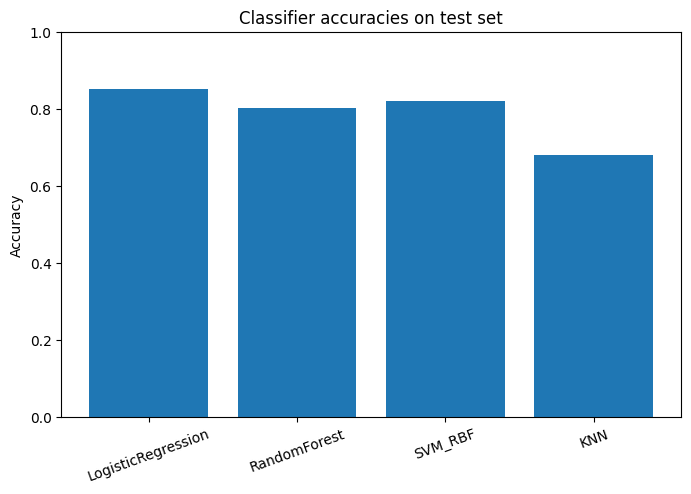

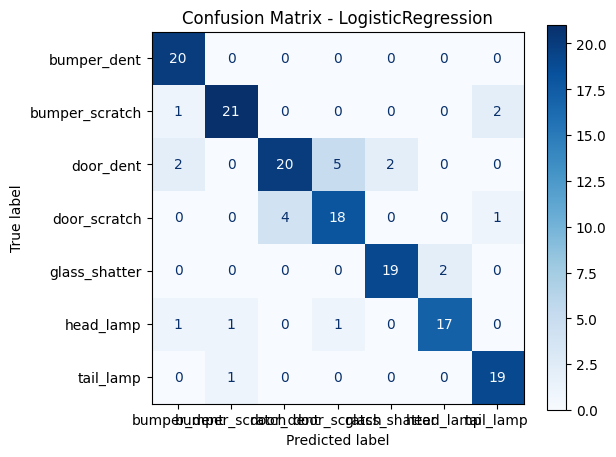

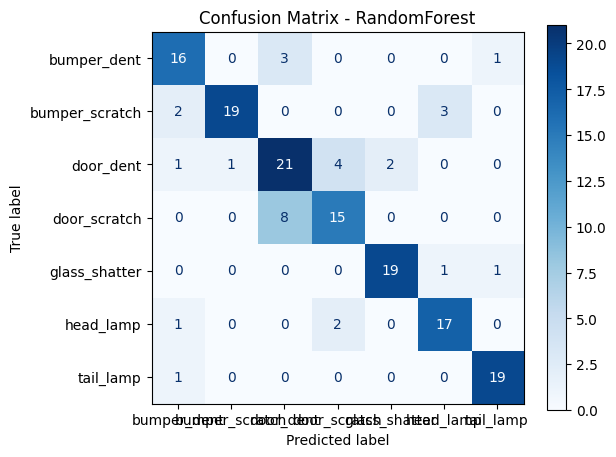

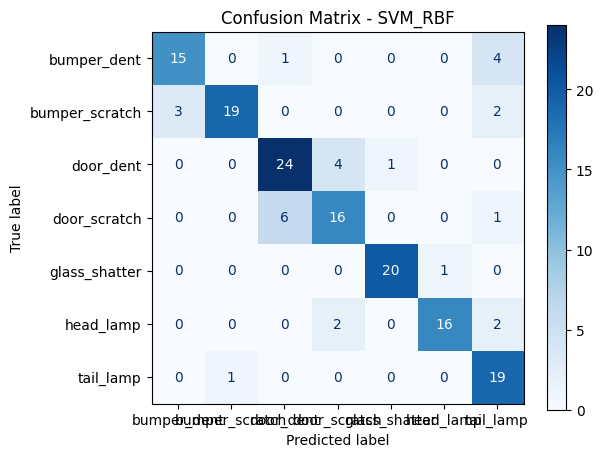

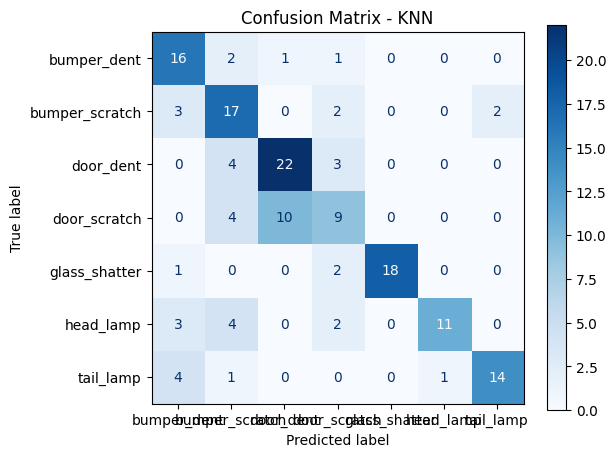

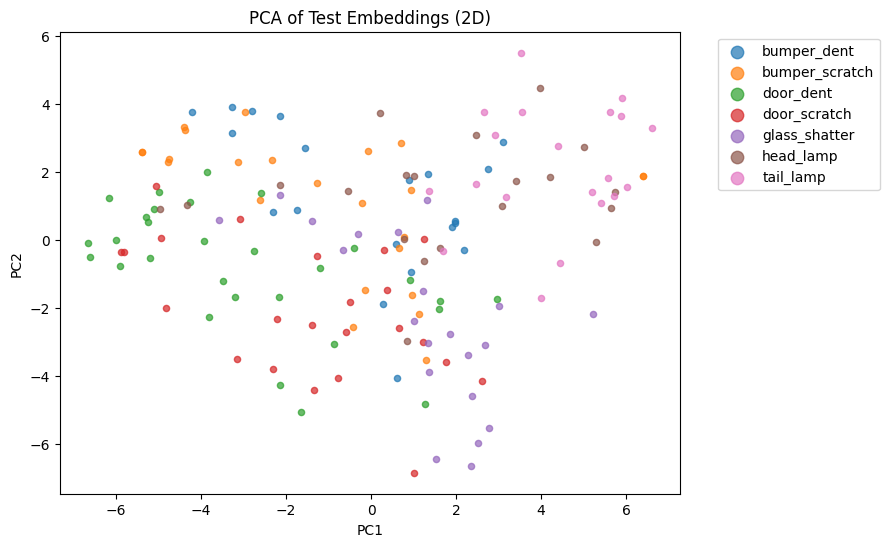

In [ ]:
# 1) Bar plot of accuracies
names = list(results.keys())
accs = [results[n] for n in names]

plt.figure(figsize=(8,5))
plt.bar(names, accs)
plt.title("Classifier accuracies on test set")
plt.ylabel("Accuracy")
plt.ylim(0,1)
plt.xticks(rotation=20)
plt.show()

# 2) Confusion matrices (مخططات)
from sklearn.metrics import ConfusionMatrixDisplay
for name, clf in trained_models.items():
    y_pred = clf.predict(X_test)
    cm = confusion_matrix(y_test, y_pred)
    disp = ConfusionMatrixDisplay(cm, display_labels=le.classes_)
    plt.figure(figsize=(6,5))
    disp.plot(values_format='d', cmap='Blues', ax=plt.gca())
    plt.title(f"Confusion Matrix - {name}")
    plt.show()

# 3) PCA 2D visualization of embeddings colored by true class
from sklearn.decomposition import PCA

pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(X_test)

plt.figure(figsize=(8,6))
for i, cls in enumerate(le.classes_):
    idxs = np.where(y_test == i)[0]
    plt.scatter(X_pca[idxs,0], X_pca[idxs,1], label=cls, s=20, alpha=0.7)
plt.legend(markerscale=2, bbox_to_anchor=(1.05,1), loc='upper left')
plt.title("PCA of Test Embeddings (2D)")
plt.xlabel("PC1"); plt.ylabel("PC2")
plt.show()


##PHASE 11 — Learning Curve

Plot learning curve for the chosen classifier to check:

- Underfitting

- Overfitting

- Scalability with more data

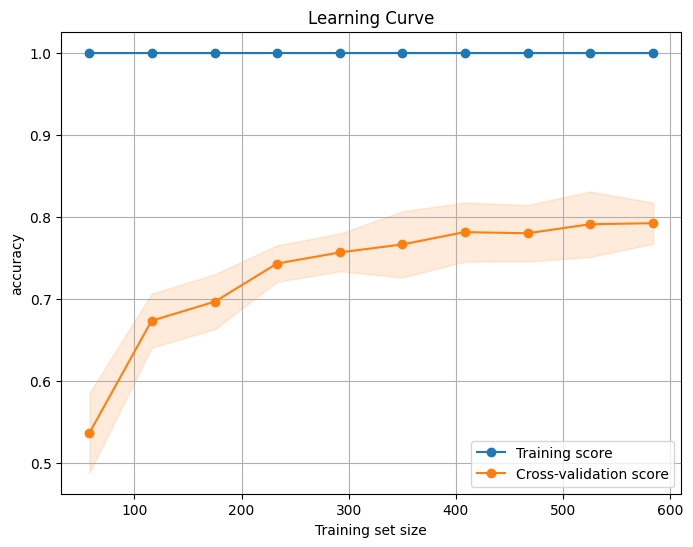

In [ ]:
from sklearn.model_selection import learning_curve
import numpy as np
import matplotlib.pyplot as plt

def plot_sklearn_learning_curve(estimator, X, y, cv=5, scoring='accuracy', train_sizes=np.linspace(0.1,1.0,10), figsize=(8,6)):
    train_sizes, train_scores, valid_scores = learning_curve(
        estimator, X, y, cv=cv, scoring=scoring, train_sizes=train_sizes, n_jobs=-1, shuffle=True, random_state=42
    )
    train_mean = np.mean(train_scores, axis=1)
    train_std  = np.std(train_scores, axis=1)
    valid_mean = np.mean(valid_scores, axis=1)
    valid_std  = np.std(valid_scores, axis=1)

    plt.figure(figsize=figsize)
    plt.plot(train_sizes, train_mean, 'o-', color='C0', label='Training score')
    plt.fill_between(train_sizes, train_mean-train_std, train_mean+train_std, alpha=0.15, color='C0')
    plt.plot(train_sizes, valid_mean, 'o-', color='C1', label='Cross-validation score')
    plt.fill_between(train_sizes, valid_mean-valid_std, valid_mean+valid_std, alpha=0.15, color='C1')
    plt.title('Learning Curve')
    plt.xlabel('Training set size')
    plt.ylabel(scoring)
    plt.legend(loc='best')
    plt.grid(True)
    plt.show()

# (LogisticRegression pipeline)
plot_sklearn_learning_curve(trained_models['LogisticRegression'], X_train, y_train, cv=5)


##PHASE 12 — ROC AUC Score

Compute macro-averaged ROC AUC for classifiers that support probabilities.

In [ ]:
# prepare binarized y_test
n_classes = len(le.classes_)
y_test_bin = label_binarize(y_test, classes=list(range(n_classes)))

for name, clf in trained_models.items():
    try:
        # try to get probability estimates
        probas = clf.predict_proba(X_test)
        auc = roc_auc_score(y_test_bin, probas, average='macro', multi_class='ovr')
        print(f"{name} ROC AUC (macro, ovr) = {auc:.4f}")
    except Exception as e:
        print(f"{name} - cannot compute ROC AUC (predict_proba missing) — {e}")


LogisticRegression ROC AUC (macro, ovr) = 0.9827
RandomForest ROC AUC (macro, ovr) = 0.9700
SVM_RBF ROC AUC (macro, ovr) = 0.9818
KNN ROC AUC (macro, ovr) = 0.9190


## PHASE 13 — Predict Unknown Images

Steps:

1. Load unknown image list

2. Clean inconsistent paths

3. Load best classifier + label encoder

4. Predict label & confidence

5. Apply business rule:

if confidence < 0.60 → No Damage


6. Display images with predictions

7. Print predictions in console

In [ ]:
# ============================================================
#  FIND UNKNOWN IMAGES
# ============================================================

import pandas as pd
import os

# Load CSV
data_csv = pd.read_csv('/content/drive/MyDrive/Dataset/input/car-damage-assessment/data.csv')

# Filter images with label == 'unknown'
unknown_images = data_csv[data_csv['classes'] == 'unknown']['image'].tolist()

# Remove 'image/' prefix if it exists
unknown_images = [img.replace('image/', '') for img in unknown_images]

print(f" Found {len(unknown_images)} unknown images (after cleaning paths).")

# Verify first few
for img_name in unknown_images[:5]:
    img_path = os.path.join('/content/drive/MyDrive/Dataset/input/car-damage-assessment/image', img_name)
    exists = os.path.exists(img_path)
    print(f"{img_name} --> {' Found' if exists else ' Not Found'}")

 Found 549 unknown images (after cleaning paths).
0.jpeg -->  Found
4.jpeg -->  Found
5.jpeg -->  Found
7.jpeg -->  Found
15.jpeg -->  Found


## PHASE 14 — Save Feature Extractor & Best Classifier

Save:

EfficientNet feature extractor (.h5)

Best classifier (.joblib)

Label encoder (.joblib)

In [ ]:
# Load best classifier + label encoder
best_clf = joblib.load(os.path.join(OUT_DIR, f"best_sklearn_{best_clf_name}.joblib"))
label_encoder = joblib.load(os.path.join(OUT_DIR, "label_encoder.joblib"))

print("Best classifier and label encoder loaded successfully!")


Best classifier and label encoder loaded successfully!


In [ ]:
def predict_unknown_image(img_path, feature_model, classifier, target_size=IMG_SIZE):
    # تحميل الصورة
    img = load_img(img_path, target_size=target_size)
    arr = img_to_array(img)

    # نفس preprocessing اللي استخدمتيه في extraction
    arr = preprocess_input(arr)
    arr = np.expand_dims(arr, axis=0)

    # استخراج embedding
    feat = feature_model.predict(arr, verbose=0)   # shape (1, feat_dim)

    # توقع
    pred = classifier.predict(feat)
    class_idx = int(pred[0])
    class_name = label_encoder.inverse_transform([class_idx])[0]

    # محاولة حساب الـ confidence
    try:
        pred_proba = classifier.predict_proba(feat)[0]
        confidence = pred_proba[class_idx]
    except:
        confidence = None   # إذا المودل ما يدعم prob مثل SVM بدون probability=True

    return class_name, confidence


Found 1512 unknown images.

1071.jpeg → Predicted: door_dent (confidence=0.783)


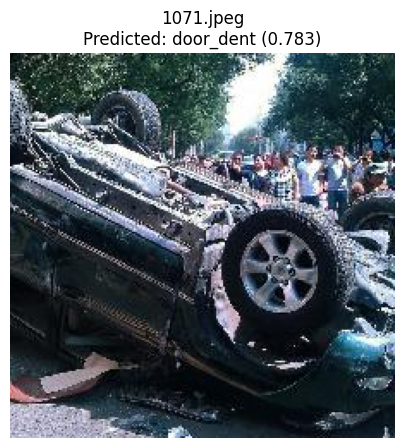

785.jpeg → Predicted: bumper_scratch (confidence=0.999)


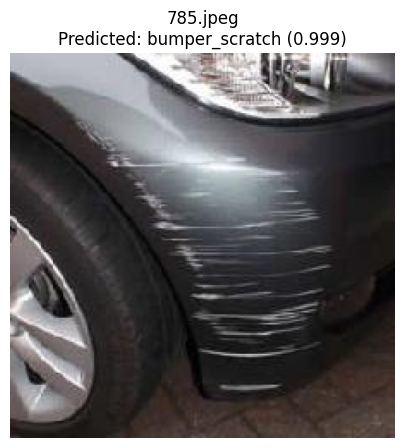

559.jpeg → Predicted: door_scratch (confidence=0.960)


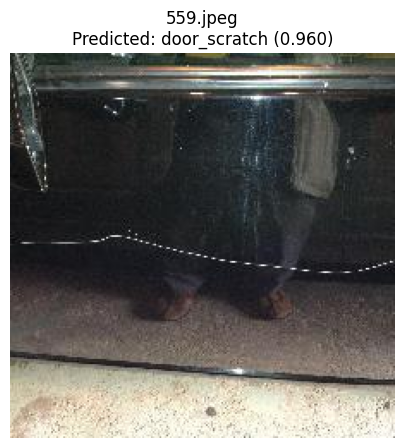

906.jpeg → Predicted: No Damage (confidence=0.435)


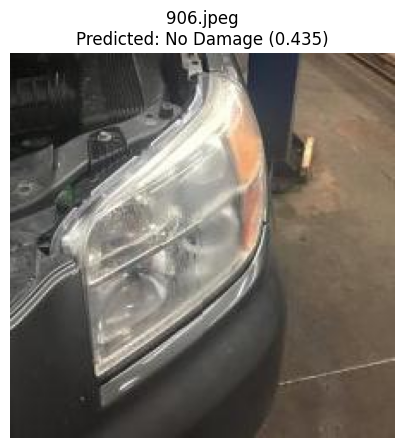

378.jpeg → Predicted: glass_shatter (confidence=1.000)


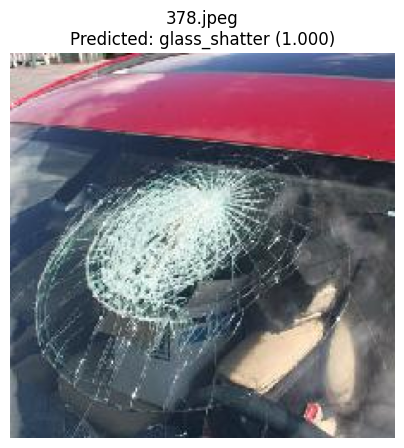

In [ ]:
import os
import random
import matplotlib.pyplot as plt
import cv2

# ضع مسار مجلد الصور غير المعروفة
UNKNOWN_DIR = "/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/image"

if os.path.exists(UNKNOWN_DIR):

    # جمع كل الصور
    unknown_files = [f for f in os.listdir(UNKNOWN_DIR)
                     if f.lower().endswith(('png','jpg','jpeg'))]

    print(f"Found {len(unknown_files)} unknown images.\n")

    # اختيار 5 صور عشوائياً كل مرة
    random.shuffle(unknown_files)
    unknown_files = unknown_files[:5]

    for fname in unknown_files:
        img_path = os.path.join(UNKNOWN_DIR, fname)

        # ---- Run prediction ----
        cls, conf = predict_unknown_image(img_path, feature_model, best_clf)

        # ---- Apply confidence threshold ----
        if conf is None:
            final_label = cls
        else:
            if conf < 0.60:
                final_label = "No Damage"
            else:
                final_label = cls

        # ---- Read and display image ----
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        plt.figure(figsize=(5,5))
        plt.imshow(img)
        plt.axis("off")

        if conf is None:
            plt.title(f"{fname}\nPredicted: {final_label}")
            print(f"{fname} → Predicted: {final_label}")
        else:
            plt.title(f"{fname}\nPredicted: {final_label} ({conf:.3f})")
            print(f"{fname} → Predicted: {final_label} (confidence={conf:.3f})")

        plt.show()

else:
    print("UNKNOWN_DIR not found. Please set the correct path.")


In [ ]:
FEATURE_MODEL_PATH = "/content/drive/MyDrive/features_efficientnet_finetune/feature_extractor.h5"
feature_model.save(FEATURE_MODEL_PATH)
print("Saved:", FEATURE_MODEL_PATH)


Saved: /content/drive/MyDrive/features_efficientnet_finetune/feature_extractor.h5


In [ ]:
import joblib

OUT_DIR = "/content/drive/MyDrive/features_efficientnet_finetune"

joblib.dump(best_clf, f"{OUT_DIR}/best_classifier.joblib")
joblib.dump(le, f"{OUT_DIR}/label_encoder.joblib")

print("Classifier + Label encoder saved.")


Classifier + Label encoder saved.


## PHASE 15 — Load Models for Deployment

Reload everything:

Feature extractor

Best classifier

Label encoder

Ensure prediction consistency.

In [ ]:
from tensorflow.keras.models import load_model
import joblib

FEATURE_MODEL_PATH = "/content/drive/MyDrive/features_efficientnet_finetune/feature_extractor.h5"
CLASSIFIER_PATH = "/content/drive/MyDrive/features_efficientnet_finetune/best_classifier.joblib"
LABEL_ENCODER_PATH = "/content/drive/MyDrive/features_efficientnet_finetune/label_encoder.joblib"

feature_model = load_model(FEATURE_MODEL_PATH)
classifier = joblib.load(CLASSIFIER_PATH)
le = joblib.load(LABEL_ENCODER_PATH)

print("Models loaded successfully!")


Models loaded successfully!


## PHASE 16 — Final Prediction Demo

Pick 5 random images and perform final prediction using:

predict_unknown_image()


Display images + class + confidence.

Total unknown images: 1512
1129.jpeg → glass_shatter (conf=0.9859632273642644)


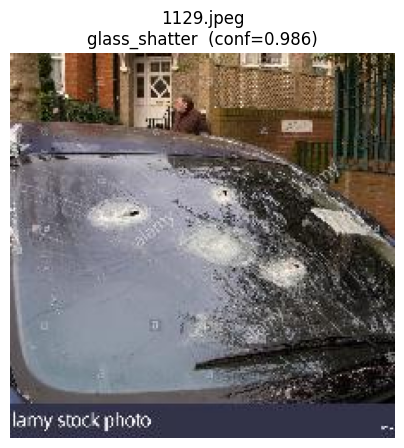

1265.jpeg → No Damage (conf=0.4579968004973517)


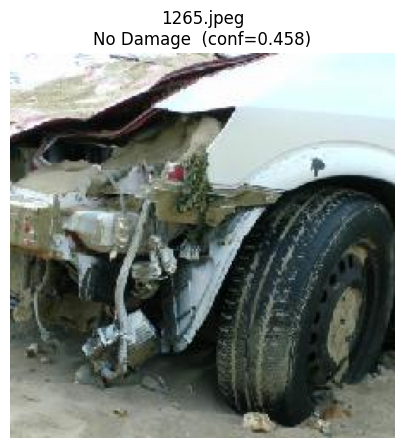

1381.jpeg → door_dent (conf=0.9837530536366231)


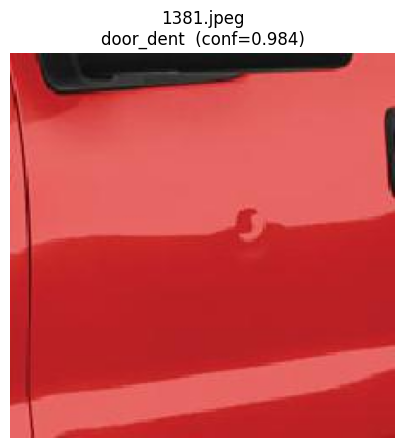

195.jpeg → glass_shatter (conf=0.9999952397170769)


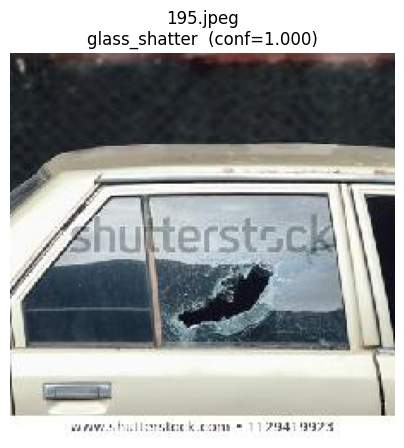

968.jpeg → tail_lamp (conf=0.9445941968588262)


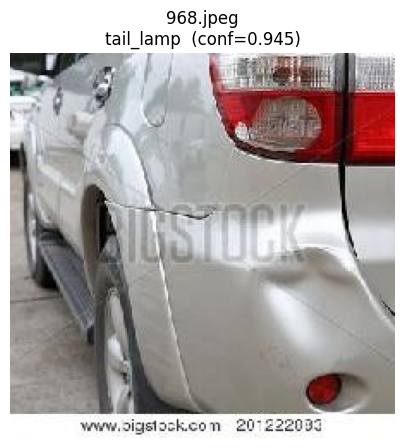

In [ ]:
import os
import random
import cv2
import matplotlib.pyplot as plt

UNKNOWN_DIR = "/content/drive/MyDrive/Dataset/input/car-damage-assessment/1/image"

# أخذ 5 صور عشوائية
unknown_files = [f for f in os.listdir(UNKNOWN_DIR)
                 if f.lower().endswith(('png','jpg','jpeg'))]

print(f"Total unknown images: {len(unknown_files)}")

# اختار 5 عشوائية
random_files = random.sample(unknown_files, 5)

for fname in random_files:
    img_path = os.path.join(UNKNOWN_DIR, fname)

    cls, conf = predict_unknown_image(img_path, feature_model, classifier)

    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Rule: if confidence < 0.6 → No Damage
    if conf is not None and conf < 0.60:
        cls_to_show = "No Damage"
    else:
        cls_to_show = cls

    plt.figure(figsize=(5,5))
    plt.imshow(img)
    plt.axis("off")

    if conf is not None:
        plt.title(f"{fname}\n{cls_to_show}  (conf={conf:.3f})")
    else:
        plt.title(f"{fname}\n{cls_to_show}")

    print(f"{fname} → {cls_to_show} (conf={conf})")
    plt.show()


#Overall Model Performance Summary and Final Decision

A comprehensive comparison was conducted across three modeling approaches: a custom CNN trained from scratch, EfficientNetB0, and full fine-tuning of DenseNet201. The results demonstrate a clear performance hierarchy.

DenseNet201 Fine-Tuning — Final Test Accuracy: 88.5%

EfficientNetB0  — Final Test Accuracy: 85.35%

 CNN — Final Test Accuracy: 18.47%

Final Decision:
DenseNet201 Fine-Tuning was selected as the final model due to its superior generalization, stable learning curves, and high accuracy across all seven damage categories. Its strong feature extraction and transfer-learning capabilities make it the most reliable and deployment-ready solution for car damage assessment.